# Figures

In [1]:
import numpy as np                                # scientific computing toolkit
import pandas as pd                               # data analysis toolkit
import scanpy as sc                               # scanpy is referred to with sc.***
import scvelo as scv                              # RNA velocity toolkit
import matplotlib.pyplot as plt                   # Matplotlib is referred to with plt.***
from matplotlib_venn import venn3, venn3_circles  # Venn diagrams
from scipy import stats                           # for linear regressions
import seaborn as sns                             # for easy heatmaps
import scirpy as ir                               # TCR analysis
import itertools
import gseapy
from scipy.stats import kruskal
from scipy.stats import mannwhitneyu
from scipy.stats import ttest_ind

sc.settings.verbosity = 0                         # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()                       # check if all needed versions are installed and up to date

scanpy==1.8.1 anndata==0.7.6 umap==0.4.6 numpy==1.19.5 scipy==1.6.1 pandas==1.2.3 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.9.6 leidenalg==0.8.3 pynndescent==0.5.2


In [2]:
def convert_significance(p):
    text=''
    if p>=0.05:
        text='p=%.2f' % p
    if p<0.05:
        text='*'
    if p<0.01:
        text='**'
    if p<0.001:
        text='***'
    if p<0.0001:
        text='****'
    return text

In [3]:
sc.settings.set_figure_params(dpi=80, dpi_save=300, color_map='viridis')
clonotypes_re_expression=['0','1','4','8','9','42','122']
order=['Blood_before','Infusion_product','Blood_after']
adata = sc.read('adata_figures.h5ad')
#adata.obs.clonotype[adata.obs.clonotype=='472']='471'
clonotypes_greater_2=adata.obs.clone_id[adata.obs.clone_id_size>2].unique().tolist()
adata=adata[adata.obs.leiden!='6'] #exclude cluster containing non T cells (Monocyte impurities)

In [4]:
adata=adata[~adata.obs.chain_pairing.str.contains('orphan')].copy()

In [5]:
chain_pairing_all=np.round((adata.obs.chain_pairing.value_counts(normalize=True)*100),1).astype('str')+' %'
chain_pairing_T=np.round((adata[adata.raw[:,'CD3D'].X>0, : ].obs.chain_pairing.value_counts(normalize=True)*100),1).astype('str')+' %'

In [6]:
print('%.2f' % ((adata[adata.obs.chain_pairing.isin(['single pair', 'extra VDJ', 'extra VJ', 'two full chains'])].shape[0]/adata.shape[0])*100)+' % of the cells have at least one alpha/beta pair')
print('%.2f' % ((adata[adata.obs.chain_pairing.isin(['single pair', 'extra VDJ', 'extra VJ', 'two full chains'])].shape[0]/adata[adata.raw[:,'CD3D'].X>0, : ].shape[0])*100)+' % of the T cells have at least one alpha/beta pair')

86.38 % of the cells have at least one alpha/beta pair
97.14 % of the T cells have at least one alpha/beta pair


In [7]:
adata.obs.samplename.cat.rename_categories({'Blood_before':'PB-pre','Blood_after':'PB-post','Infusion_product':'TIL'}, inplace=True)
adata.uns['samplename_colors']=['#b80000','#e86464','#a3a3a3'] #['#1f77b4', '#ff7f0e', '#279e68']
adata.uns['leiden_colors']=['#1f77b4', '#ff7f0e', '#279e68', '#aa40fc','#e377c2','#7f7f7f'] #['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b']
#adata.uns['leiden_colors']=['#404040', '#6e6e6e', '#a8a8a8', '#d1d1d1','#8a8a8a','#000000']

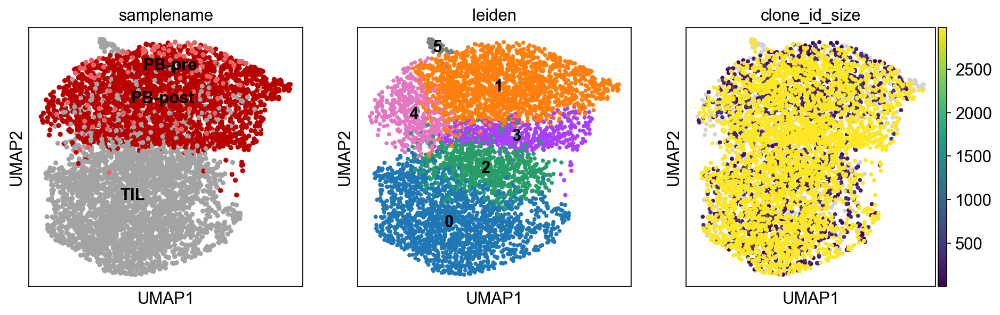

In [8]:
fig,ax = plt.subplots(ncols=3, figsize=(14,4))
sc.pl.umap(adata, color='samplename', show=False, legend_loc='on data', s=70, ax=ax[0])
sc.pl.umap(adata[adata.obs.samplename=='PB-pre'].copy(), color='samplename', show=False, legend_loc='on data', s=70, ax=ax[0])
sc.pl.umap(adata, color='leiden', show=False, legend_loc='on data', s=50, ax=ax[1])
sc.pl.umap(adata, color='clone_id_size', s=50, show=False, ax=ax[2])
fig.savefig('./figures_paper/umaps.svg', dpi=300, bbox_inches='tight')

In [9]:
data=adata.obs.groupby(['samplename']).count()
data=pd.DataFrame(index=['PB-post', 'PB-pre', 'TIL'], columns=['0','1','2','3','4','5'])
for column in data.columns.tolist():
    for row in data.index.tolist():
        data.loc[row,column]=adata[(adata.obs.samplename==row) & (adata.obs.leiden==column)].shape[0]

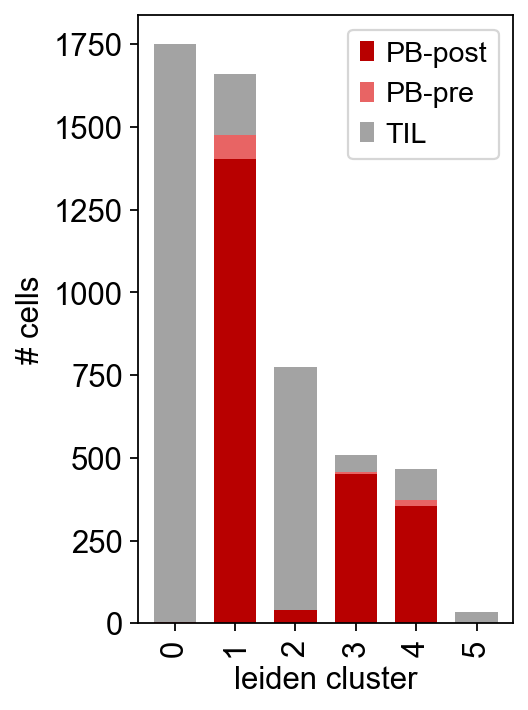

In [10]:
fig, ax=plt.subplots(figsize=(3,5))
data[['0','1','2','3','4','5']].T.plot(kind='bar', stacked=True, color=['#b80000','#e86464','#a3a3a3'], ax=ax, grid=False, width=0.7)
ax.set_xlabel('leiden cluster')
ax.set_ylabel('# cells')
plt.show()
fig.savefig('./figures_paper/n_cells_clusters.svg', dpi=300, bbox_inches='tight')

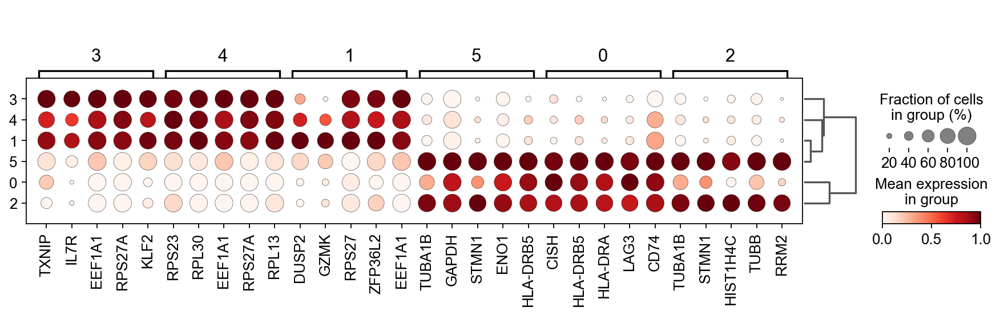

In [11]:
sc.tl.dendrogram(adata, groupby='leiden')
sc.tl.rank_genes_groups(adata, 'leiden', use_raw=True, method='t-test')
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, show=False, standard_scale='var')
plt.savefig('./figures_paper/dotplot_leiden.svg', dpi=300, bbox_inches='tight')

In [12]:
naming_reference=pd.read_excel('Protein_Barcodes.xlsx', header=1, index_col=0)

In [13]:
new_annotation=(naming_reference.Description.str.replace('anti-human ','').str.replace('anti-human/mouse ','').str.replace('anti-mouse/human ','').str.replace('anti-human/mouse/rat ','')+'_SP').tolist()

In [14]:
naming_reference.Description=new_annotation

In [15]:
new_citeseq_data=pd.DataFrame(adata.obs.loc[:,adata.obs.columns.str.endswith('_SP')].values, columns=new_annotation, index=adata.obs_names)

In [16]:
adata.obs=adata.obs.drop(adata.obs.columns[adata.obs.columns.str.endswith('_SP')], axis=1)

In [17]:
adata.obs=pd.merge(adata.obs, new_citeseq_data, how='left', left_index=True, right_index=True)

In [18]:
def get_SP(marker):
    protein=naming_reference[naming_reference['Gene name']==marker].Description.tolist()[0]
    return(protein)

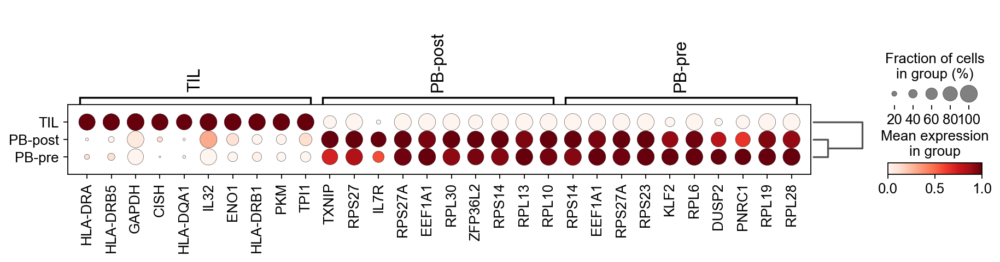

In [19]:
sc.tl.dendrogram(adata, groupby='samplename')
sc.tl.rank_genes_groups(adata, 'samplename', use_raw=True, method='t-test')
sc.pl.rank_genes_groups_dotplot(adata, n_genes=10, show=False, standard_scale='var')
plt.savefig('./figures_paper/dotplot_samplename.svg', dpi=300, bbox_inches='tight')

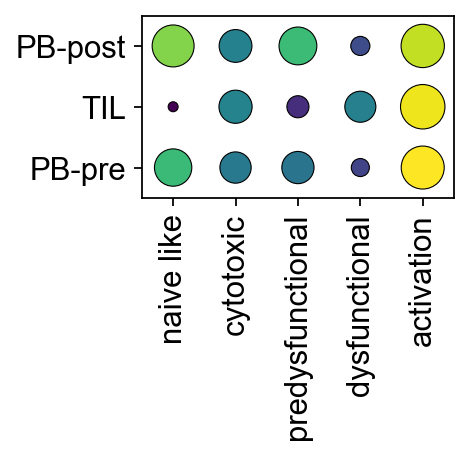

In [20]:
fig,ax=plt.subplots(figsize=(2.5,1.5))
df_dotplot=adata.obs.groupby('samplename').agg({'naive_like_state':'mean',
                                                'cytotoxic_state':'mean',
                                                'predysfunctional_state':'mean', 
                                                'dysfunctional_state':'mean',
                                                'activation_score':'mean'})
df_dotplot=df_dotplot.loc[['PB-pre','TIL','PB-post']]
df_size=df_dotplot.copy()
for column in df_size.columns:
    df_size[column]=adata.obs[adata.obs[column] > 0].groupby('samplename')['cytotoxic_activation'].count()/adata.obs.groupby('samplename')['cytotoxic_activation'].count()

sns.scatterplot(x=df_dotplot.columns.tolist()*df_dotplot.index.shape[0],
            y=list(itertools.chain(*[[df_dotplot.index.tolist()[i]]*df_dotplot.columns.shape[0] for i in range(df_dotplot.shape[0])])), size=df_size.values.flatten().tolist(),
            hue=df_dotplot.values.flatten().tolist(), edgecolor='black', linewidth=.5, ax=ax, 
            sizes=(20,400), palette='viridis', vmin=0)
ax.set_xticklabels(['naive like', 'cytotoxic', 'predysfunctional', 'dysfunctional', 'activation'], rotation=90)
ax.get_legend().remove()
ax.set_xlim([-0.5,4.5])
ax.set_ylim([-0.5,2.5])
ax.grid(None)
plt.savefig('./figures_paper/dotplot_scores_absolute.svg', dpi=300, bbox_inches='tight')
plt.show()

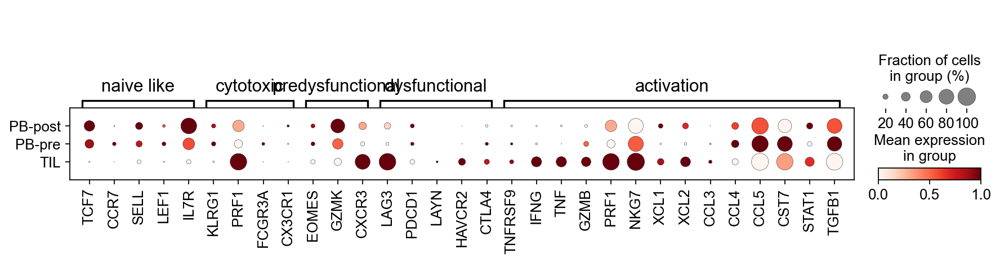

In [21]:
t=sc.pl.dotplot(adata, var_names=['TCF7','CCR7','SELL','LEF1','IL7R',
                                  'KLRG1','PRF1','FCGR3A','CX3CR1',
                                  'EOMES', 'GZMK', 'CXCR3',
                                  'LAG3', 'PDCD1', 'LAYN', 'HAVCR2','CTLA4',
                                  'TNFRSF9','IFNG','TNF','GZMB','PRF1','NKG7','XCL1','XCL2','CCL3','CCL4','CCL5','CST7','STAT1','TGFB1'], 
              var_group_positions=[(0,4),(5,8),(9,11),(12,16),(17,30)],
              var_group_labels=['naive like' ,'cytotoxic', 'predysfunctional', 'dysfunctional','activation'], groupby='samplename',
             standard_scale='var', var_group_rotation=0, show=False)
plt.savefig('./figures_paper/dotplot_score_genes.svg', dpi=300, bbox_inches='tight')

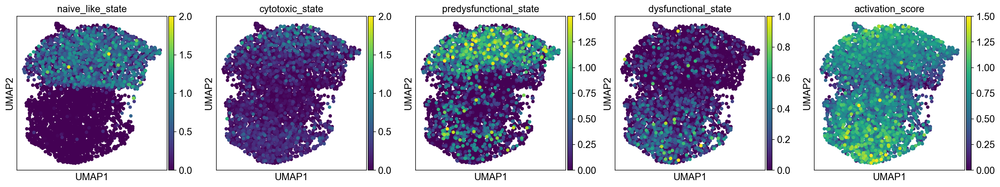

In [22]:
sc.pl.umap(adata, color=['naive_like_state','cytotoxic_state','predysfunctional_state', 'dysfunctional_state','activation_score'], ncols=5, s=100, vmax=[2,2,1.5,1,1.5],vmin=0, show=False, color_map='viridis')
plt.savefig('./figures_paper/feature_plot_scores.svg', dpi=300, bbox_inches='tight')

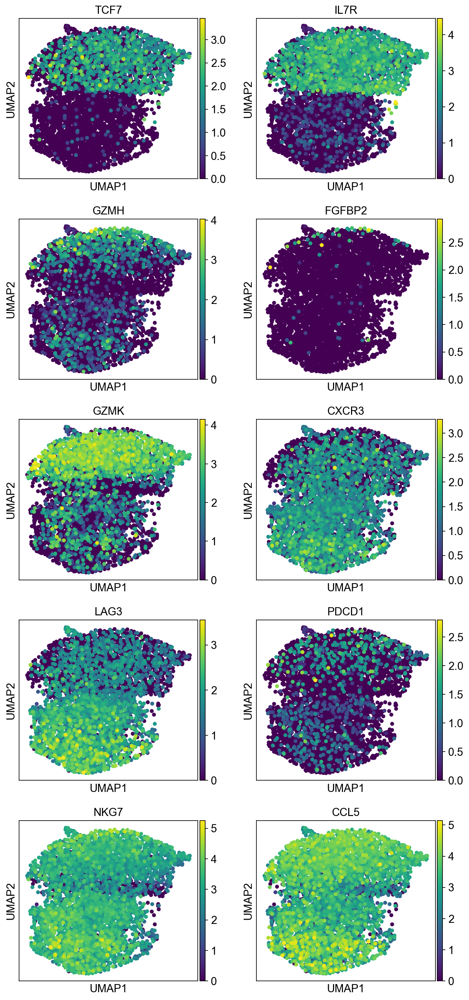

In [23]:
sc.pl.umap(adata, color=['TCF7','IL7R','GZMH','FGFBP2','GZMK','CXCR3','LAG3','PDCD1','NKG7','CCL5'], ncols=2, s=100, show=False,color_map='viridis')
plt.savefig('./figures_paper/feature_plot_score_genes.svg', dpi=300, bbox_inches='tight')

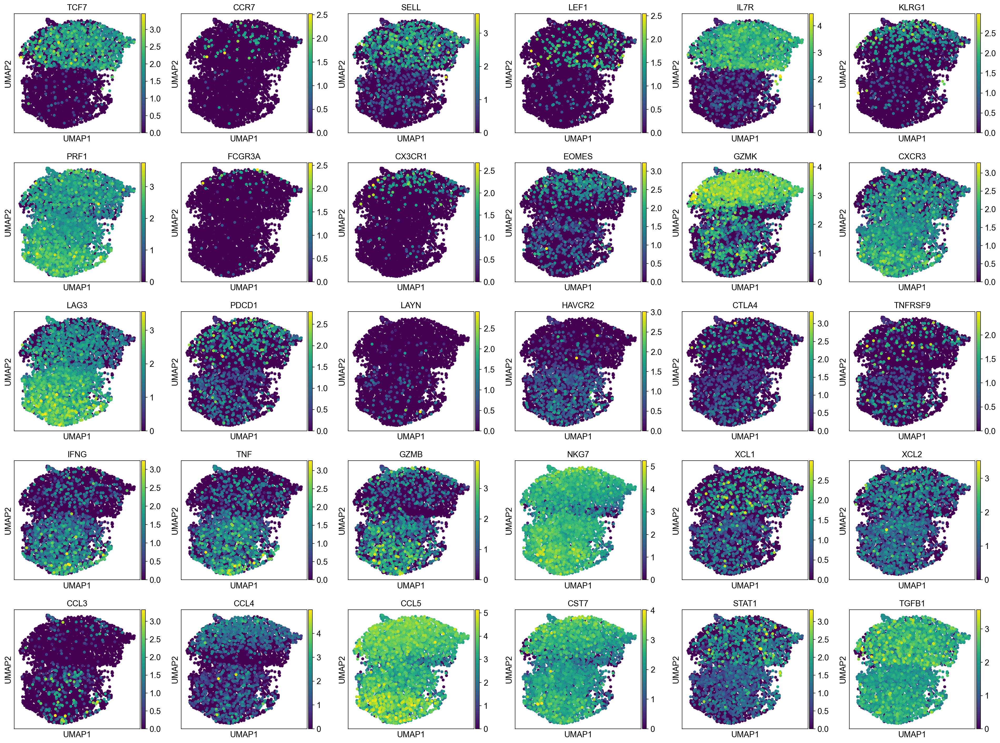

In [24]:
sc.pl.umap(adata, color=['TCF7','CCR7','SELL','LEF1','IL7R',
                                  'KLRG1','PRF1','FCGR3A','CX3CR1',
                                  'EOMES', 'GZMK', 'CXCR3',
                                  'LAG3', 'PDCD1', 'LAYN', 'HAVCR2','CTLA4',
                                  'TNFRSF9','IFNG','TNF','GZMB','NKG7','XCL1','XCL2','CCL3','CCL4','CCL5','CST7','STAT1','TGFB1'], ncols=6, s=100, show=False)
plt.savefig('./figures_paper/feature_plot_score_genes.svg', dpi=300, bbox_inches='tight')

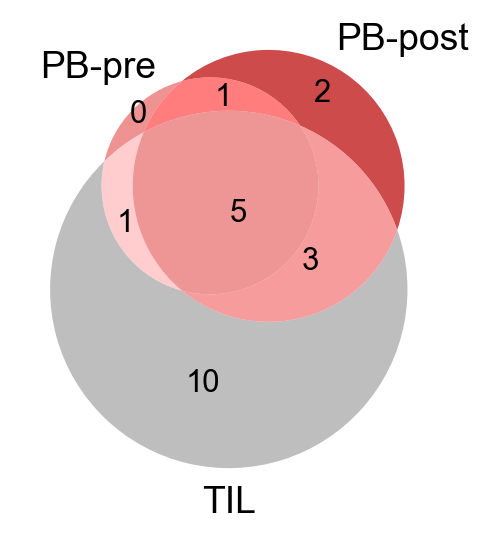

In [25]:
list_pb_pre=adata.obs[(adata.obs.samplename=='PB-pre')&(adata.obs.clone_id_size>2)].clone_id.unique().tolist()
list_pb_post=adata.obs[(adata.obs.samplename=='PB-post')&(adata.obs.clone_id_size>2)].clone_id.unique().tolist()
list_TIL=adata.obs[(adata.obs.samplename=='TIL')&(adata.obs.clone_id_size>2)].clone_id.unique().tolist()
venn3([set(list_pb_pre),set(list_pb_post),set(list_TIL)], set_labels=('PB-pre', 'PB-post', 'TIL'), set_colors=['#e86464','#b80000','#a3a3a3'], alpha=0.7)
plt.savefig('./figures_paper/clonotype_venn.svg', dpi=300, bbox_inches='tight')

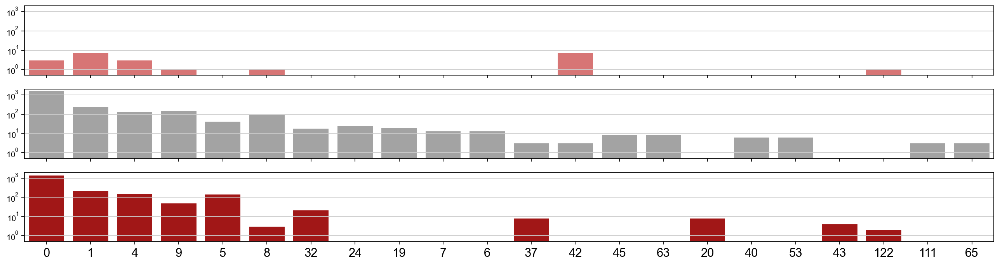

In [26]:
fig, ax=plt.subplots(nrows=3, figsize=(20,5), sharex=True)
data=adata.obs[adata.obs.clone_id_size>2].sort_values('clone_id_size', ascending=False).groupby(['clone_id','samplename'], sort=False).agg({'clone_id_size':'count', 'clone_id':'first', 'samplename':'first'})
sns.barplot(data=data, x='clone_id', y='clone_id_size', ax=ax[0], hue='samplename', hue_order=['PB-pre'], palette=['#e86464'])
sns.barplot(data=data, x='clone_id', y='clone_id_size', ax=ax[1], hue='samplename', hue_order=['TIL'], palette=['#a3a3a3'])
sns.barplot(data=data, x='clone_id', y='clone_id_size', ax=ax[2], hue='samplename', hue_order=['PB-post'], palette=['#b80000'])
for ax in ax:
    ax.set_yscale('log')
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.get_legend().remove()
    ax.set_ylim([0.5,2000])
    ax.set_yticks([1,10,100,1000])
    ax.tick_params(axis='y', which='major', labelsize=9)
#ax.set_xticklabels(['* '+x if x in clonotypes_re_expression else x for x in data.index.get_level_values(0).categories.tolist()], rotation=90)
fig.savefig('./figures_paper/clonotype_size_samplename.svg', dpi=300, bbox_inches='tight')
plt.show()

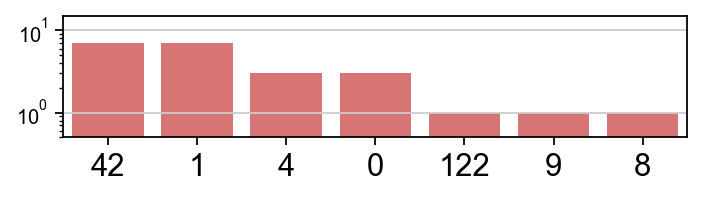

In [27]:
fig, ax=plt.subplots(figsize=(5,1), sharex=True)
data=adata.obs[(adata.obs.clone_id_size>2)&(adata.obs.samplename=='PB-pre')].sort_values('clone_id_size', ascending=False).groupby(['clone_id','samplename'], sort=False).agg({'clone_id_size':'count', 'clone_id':'first', 'samplename':'first'})
data=data.sort_values('clone_id_size', ascending=False)
sns.barplot(data=data, x='clone_id', y='clone_id_size', ax=ax, hue='samplename', hue_order=['PB-pre'], palette=['#e86464'])
ax.set_yscale('log')
ax.set_xlabel('')
ax.set_ylabel('')
ax.get_legend().remove()
ax.set_ylim([0.5,15])
ax.set_yticks([1,10])
ax.tick_params(axis='y', which='major', labelsize=9)
#ax.set_xticklabels(['* '+x if x in clonotypes_re_expression else x for x in data.index.get_level_values(0).categories.tolist()], rotation=90)
fig.savefig('./figures_paper/clonotype_size_samplename_PBpre.svg', dpi=300, bbox_inches='tight')
plt.show()

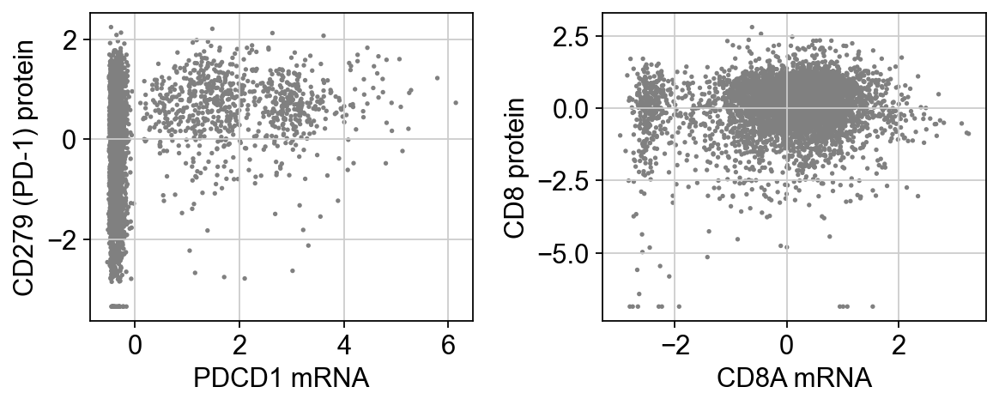

In [28]:
fig,ax=plt.subplots(ncols=2, figsize=(7.5,3))
fig.tight_layout(w_pad=2)
for i, marker in enumerate(['PDCD1', 'CD8A']):
    sc.pl.scatter(adata, marker, get_SP(marker), use_raw=False, ax=ax[i], show=False)
    ax[i].set_ylabel(get_SP(marker)[:-3]+' protein')
    ax[i].set_xlabel(marker+' mRNA')
fig.savefig('./figures_paper/correlations_mRNA_protein.svg', dpi=300, bbox_inches='tight')

In [29]:
exhaustion_genes=['HAVCR2','PDCD1','LAG3','EOMES','CD101','CD38','TIGIT']
activation_genes=['TNFRSF9','IFNG','TNF','GZMB','PRF1','NKG7','XCL1','XCL2','CCL3','CCL4','CCL5','CST7','STAT1','TGFB1']
naive_like_state_genes=['TCF7','CCR7','SELL','LEF1','IL7R']
predysfunctional_state_genes=['EOMES', 'GZMK', 'CXCR3']
dysfunctional_state_genes=['LAG3', 'PDCD1', 'LAYN', 'HAVCR2','CTLA4']
cytotoxic_state_genes=['KLRG1','PRF1','FCGR3A','CX3CR1']
cytotoxic_activation=['CCL5', 'GZMK', 'GNLY', 'EOMES', 'ZNF683','KLRG1', 'NKG7', 'ZEB2']
cytokine_activation=['CCL3', 'IFNG', 'CCL4', 'XCL1', 'XCL2', 'CSF2', 'IL10', 'HOPX', 'TIM3', 'LAG3', 'PRF1', 'TNFRSF9', 'NKG7', 'IL26']

In [30]:
genes=exhaustion_genes+activation_genes+naive_like_state_genes+predysfunctional_state_genes+dysfunctional_state_genes+\
       cytotoxic_state_genes+cytotoxic_activation+cytokine_activation

In [31]:
genes_surface=[gene for gene in genes if gene in naming_reference['Gene name'].tolist()]

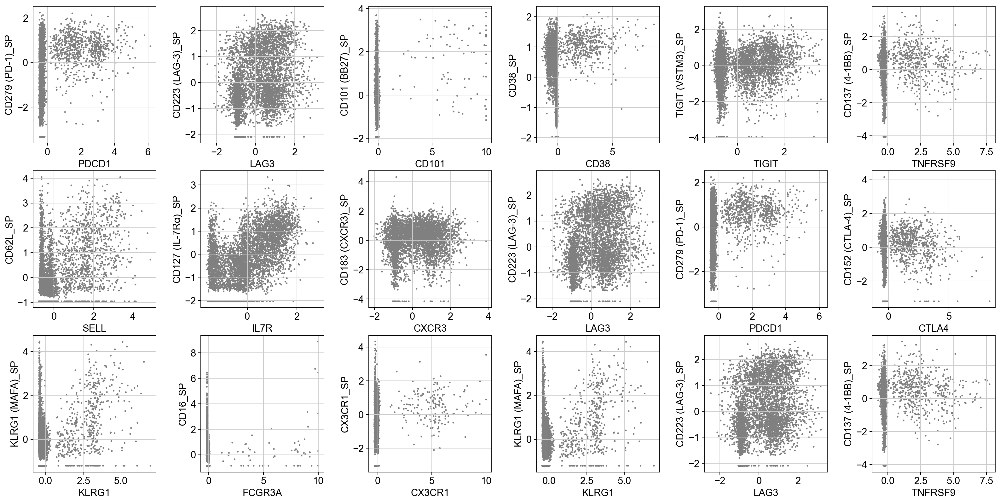

In [32]:
fig,ax=plt.subplots(nrows=3, ncols=6, figsize=(20,10))
fig.tight_layout(w_pad=2)
for i, marker in enumerate(genes_surface):
    sc.pl.scatter(adata, marker, get_SP(marker), use_raw=False, ax=ax.reshape(-1)[i], show=False)

In [33]:
adata.obs.samplename.value_counts()

TIL        2841
PB-post    2250
PB-pre      100
Name: samplename, dtype: int64

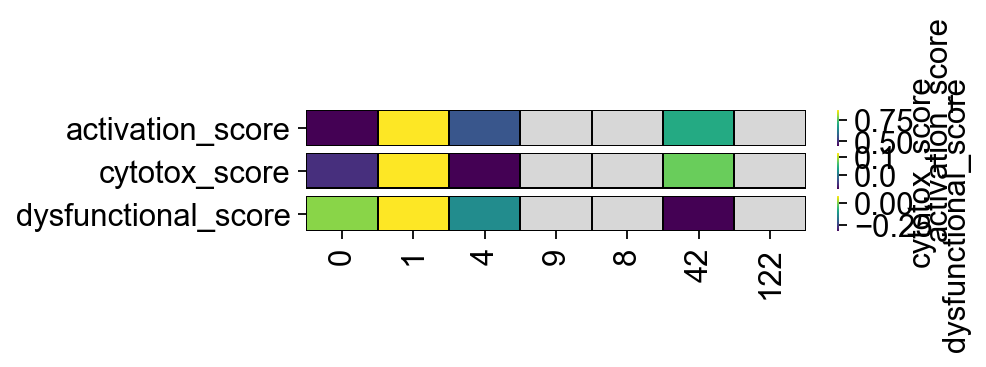

In [34]:
mask=adata.obs[(adata.obs.clone_id_size>2)&(adata.obs.samplename=='PB-pre')].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({'size_Blood_before':'mean'}).T==0
mask=mask.loc[['size_Blood_before'],mask.columns.isin(['0','1','4','9','8','42','122'])].values
fig,ax=plt.subplots(nrows=3, figsize=(5,1))
for i, measure in enumerate(['activation_score','cytotox_score', 'dysfunctional_score']):
    sizetable=adata.obs[(adata.obs.clone_id_size>2)&(adata.obs.samplename=='PB-pre')].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({'size_Blood_before':'mean'}).T
    sizetable=sizetable.loc[:,sizetable.columns.isin(['0','1','4','9','8','42','122'])]
    mask2=~((sizetable<3)&(sizetable!=0))
    mask2=mask2.loc[['size_Blood_before'],mask2.columns.isin(['0','1','4','9','8','42','122'])].values
    df=adata.obs[(adata.obs.clone_id_size>2)&(adata.obs.samplename=='PB-pre')].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({measure+'_Blood_before':'mean'})
    df=df.T
    df=df.loc[:,df.columns.isin(['0','1','4','9','8','42','122'])]
    max_value=df.values.flatten()[(sizetable.loc[['size_Blood_before'],sizetable.columns.isin(clonotypes_greater_2)]>2).values.flatten()].max()
    min_value=df.values.flatten()[(sizetable.loc[['size_Blood_before'],sizetable.columns.isin(clonotypes_greater_2)]>2).values.flatten()].min()
    sns.heatmap(df.values.tolist(), ax=ax[i], cmap='viridis', cbar_kws={'label': measure}, mask=mask, 
                linewidths=.5, linecolor='black', vmin=min_value, vmax=max_value)
    #mark sizes<3 in gray
    df2=adata.obs[(adata.obs.clone_id_size>2)&(adata.obs.samplename=='PB-pre')].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({'size_Blood_before':'mean'})
    df2=df2.T
    df2=df2.loc[:,df2.columns.isin(['0','1','4','9','8','42','122'])]
    sns.heatmap(df2.values.tolist(), ax=ax[i], cmap='gray', mask=mask2, 
                linewidths=.5, linecolor='black', vmin=-20, vmax=5, cbar=False)
    
    ax[i].set_yticklabels([measure], rotation=0, size=14)
    ax[i].set_xticklabels('')
    ax[i-1].set_xticks([])
#ax[i].set_xticklabels(['* '+x if x in clonotypes_re_expression else x for x in df.columns], rotation=90)
ax[i].set_xticklabels([x for x in df.columns], rotation=90)
plt.show()

fig.savefig('./figures_paper/clonotypes_scores_PBpre.svg', bbox_inches='tight')
plt.show()

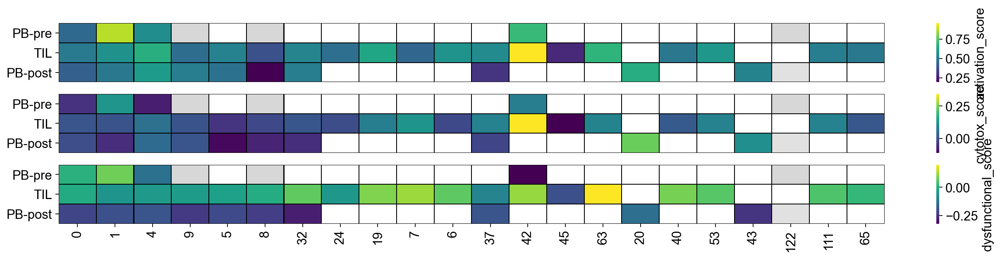

In [35]:
mask=adata.obs[adata.obs.clone_id_size>2].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({'size_Infusion_product':'mean','size_Blood_before':'mean', 'size_Blood_after':'mean'}).T==0
mask=mask.loc[['size_Blood_before','size_Infusion_product','size_Blood_after'],mask.columns.isin(clonotypes_greater_2)].values
fig,ax=plt.subplots(nrows=3, figsize=(20,4))
for i, measure in enumerate(['activation_score','cytotox_score', 'dysfunctional_score']):
    sizetable=adata.obs[adata.obs.clone_id_size>2].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({'size_Infusion_product':'mean','size_Blood_before':'mean', 'size_Blood_after':'mean'}).T
    mask2=~((sizetable<3)&(sizetable!=0))
    mask2=mask2.loc[['size_Blood_before','size_Infusion_product','size_Blood_after'],mask2.columns.isin(clonotypes_greater_2)].values
    df=adata.obs[adata.obs.clone_id_size>2].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({measure+'_Blood_before':'mean',measure+'_Infusion_product':'mean', measure+'_Blood_after':'mean'})
    df=df.T
    df=df.loc[:,df.columns.isin(clonotypes_greater_2)]
    max_value=df.values.flatten()[(sizetable.loc[['size_Blood_before','size_Infusion_product','size_Blood_after'],sizetable.columns.isin(clonotypes_greater_2)]>2).values.flatten()].max()
    min_value=df.values.flatten()[(sizetable.loc[['size_Blood_before','size_Infusion_product','size_Blood_after'],sizetable.columns.isin(clonotypes_greater_2)]>2).values.flatten()].min()
    sns.heatmap(df.values.tolist(), ax=ax[i], cmap='viridis', cbar_kws={'label': measure}, mask=mask, 
                linewidths=.5, linecolor='black', vmin=min_value, vmax=max_value)
    #mark sizes<3 in gray
    df2=adata.obs[adata.obs.clone_id_size>2].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({'size_Blood_before':'mean','size_Infusion_product':'mean', 'size_Blood_after':'mean'})
    df2=df2.T
    df2=df2.loc[:,df2.columns.isin(clonotypes_greater_2)]
    sns.heatmap(df2.values.tolist(), ax=ax[i], cmap='gray', mask=mask2, 
                linewidths=.5, linecolor='black', vmin=-20, vmax=5, cbar=False)
    
    ax[i].set_yticklabels(['PB-pre', 'TIL', 'PB-post'], rotation=0)
    ax[i].set_xticklabels('')
    ax[i-1].set_xticks([])
#ax[i].set_xticklabels(['* '+x if x in clonotypes_re_expression else x for x in df.columns], rotation=90)
ax[i].set_xticklabels([x for x in df.columns], rotation=90)
plt.show()

fig.savefig('./figures_paper/clonotypes_scores.svg', bbox_inches='tight')
plt.show()

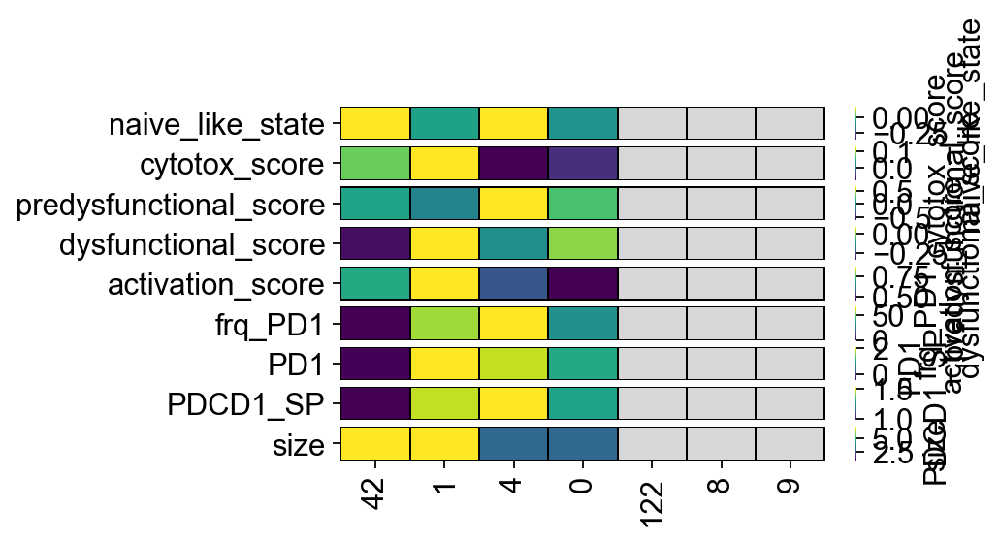

In [36]:
mask=adata.obs[(adata.obs.clone_id_size>2)&(adata.obs.samplename=='PB-pre')].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({'size_Blood_before':'mean'}).T==0
mask=mask.loc[['size_Blood_before'],mask.columns.isin(['42','1','4','0','122','8','9'])].values
fig,ax=plt.subplots(nrows=9, figsize=(5,3))
for i, measure in enumerate(['naive_like_state','cytotox_score','predysfunctional_score', 'dysfunctional_score','activation_score','frq_PD1','PD1','PDCD1_SP','size']):
    sizetable=adata.obs[(adata.obs.clone_id_size>2)&(adata.obs.samplename=='PB-pre')].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({'size_Blood_before':'mean'}).T
    sizetable=sizetable.loc[:,sizetable.columns.isin(['0','1','4','9','8','42','122'])][['42','1','4','0','122','8','9']]
    mask2=~((sizetable<3)&(sizetable!=0))
    mask2=mask2.loc[['size_Blood_before'],mask2.columns.isin(['0','1','4','9','8','42','122'])].values
    df=adata.obs[(adata.obs.clone_id_size>2)&(adata.obs.samplename=='PB-pre')].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({measure+'_Blood_before':'mean'})
    df=df.T
    df=df.loc[:,df.columns.isin(['0','1','4','9','8','42','122'])]
    max_value=df.values.flatten()[(sizetable.loc[['size_Blood_before'],sizetable.columns.isin(clonotypes_greater_2)]>2).values.flatten()].max()
    min_value=df.values.flatten()[(sizetable.loc[['size_Blood_before'],sizetable.columns.isin(clonotypes_greater_2)]>2).values.flatten()].min()
    sns.heatmap(df[['42','1','4','0','122','8','9']].values.tolist(), ax=ax[i], cmap='viridis', cbar_kws={'label': measure}, mask=mask, 
                linewidths=.5, linecolor='black', vmin=min_value, vmax=max_value)
    #mark sizes<3 in gray
    df2=adata.obs[(adata.obs.clone_id_size>2)&(adata.obs.samplename=='PB-pre')].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({'size_Blood_before':'mean'})
    df2=df2.T
    df2=df2.loc[:,df2.columns.isin(['0','1','4','9','8','42','122'])]
    sns.heatmap(df2[['42','1','4','0','122','8','9']].values.tolist(), ax=ax[i], cmap='gray', mask=mask2, 
                linewidths=.5, linecolor='black', vmin=-20, vmax=5, cbar=False)
    
    ax[i].set_yticklabels([measure], rotation=0, size=14)
    ax[i].set_xticklabels('')
    ax[i-1].set_xticks([])
#ax[i].set_xticklabels(['* '+x if x in clonotypes_re_expression else x for x in df.columns], rotation=90)
ax[i].set_xticklabels([x for x in df[['42','1','4','0','122','8','9']].columns], rotation=90)
plt.show()

fig.savefig('./figures_paper/clonotypes_scores_supp_PBpre.svg', bbox_inches='tight')
plt.show()

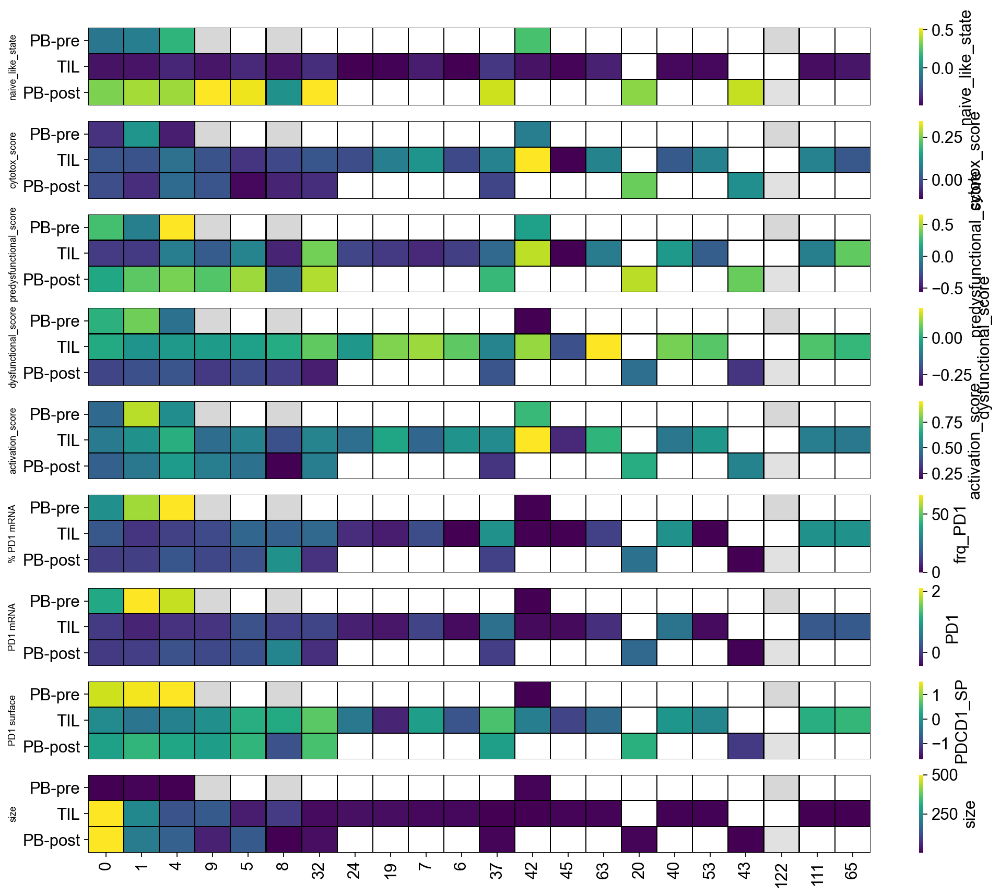

In [37]:
mask=adata.obs[adata.obs.clone_id_size>2].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({'size_Infusion_product':'mean','size_Blood_before':'mean', 'size_Blood_after':'mean'}).T==0
mask=mask.loc[['size_Blood_before','size_Infusion_product','size_Blood_after'],mask.columns.isin(clonotypes_greater_2)].values
fig,ax=plt.subplots(nrows=9, figsize=(15,13))
for i, measure in enumerate(['naive_like_state','cytotox_score','predysfunctional_score', 'dysfunctional_score','activation_score','frq_PD1','PD1','PDCD1_SP','size']):
    sizetable=adata.obs[adata.obs.clone_id_size>2].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({'size_Infusion_product':'mean','size_Blood_before':'mean', 'size_Blood_after':'mean'}).T
    mask2=~((sizetable<3)&(sizetable!=0))
    mask2=mask2.loc[['size_Blood_before','size_Infusion_product','size_Blood_after'],mask2.columns.isin(clonotypes_greater_2)].values
    df=adata.obs[adata.obs.clone_id_size>2].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({measure+'_Blood_before':'mean',measure+'_Infusion_product':'mean', measure+'_Blood_after':'mean'})
    df=df.T
    df=df.loc[:,df.columns.isin(clonotypes_greater_2)]
    max_value=df.values.flatten()[(sizetable.loc[['size_Blood_before','size_Infusion_product','size_Blood_after'],sizetable.columns.isin(clonotypes_greater_2)]>2).values.flatten()].max()
    min_value=df.values.flatten()[(sizetable.loc[['size_Blood_before','size_Infusion_product','size_Blood_after'],sizetable.columns.isin(clonotypes_greater_2)]>2).values.flatten()].min()
    if measure == 'size':
        max_value=500
    sns.heatmap(df.values.tolist(), ax=ax[i], cmap='viridis', cbar_kws={'label': measure}, mask=mask, 
                linewidths=.5, linecolor='black', vmin=min_value, vmax=max_value)
    #mark sizes<3 in gray
    df2=adata.obs[adata.obs.clone_id_size>2].sort_values('clone_id_size', ascending=False).groupby('clone_id', sort=False).agg({'size_Blood_before':'mean','size_Infusion_product':'mean', 'size_Blood_after':'mean'})
    df2=df2.T
    df2=df2.loc[:,df2.columns.isin(clonotypes_greater_2)]
    sns.heatmap(df2.values.tolist(), ax=ax[i], cmap='gray', mask=mask2, 
                linewidths=.5, linecolor='black', vmin=-20, vmax=5, cbar=False)
    
    ax[i].set_yticklabels(['PB-pre', 'TIL', 'PB-post'], rotation=0)
    ax[i].set_xticklabels('')
    ax[i-1].set_xticks([])
    ax[i].set_ylabel(measure, size=8)
ax[i].set_xticklabels([x for x in df.columns], rotation=90)
ax[5].set_ylabel('% PD1 mRNA', size=8)
ax[6].set_ylabel('PD1 mRNA', size=8)
ax[7].set_ylabel('PD1 surface', size=8)
plt.show()

fig.savefig('./figures_paper/clonotypes_scores_supp.svg', bbox_inches='tight')
plt.show()

In [38]:
df_corr=adata.obs[adata.obs.clone_id_size>2].groupby('clone_id').agg({'PDCD1_SP_Blood_before':'mean','PD1_Blood_before':'mean','size_Blood_after':'mean'})

In [39]:
df_corr['PDCD1_SP_Blood_before']=pd.cut(df_corr.PDCD1_SP_Blood_before*100, bins=[-np.inf,int((df_corr.PDCD1_SP_Blood_before*100).mean()),np.inf],labels=[ 'Low','High'])
df_corr['PD1_Blood_before']=pd.cut(df_corr.PD1_Blood_before*100, bins=[-np.inf,int((df_corr.PD1_Blood_before*100).mean()),np.inf],labels=[ 'Low','High'])

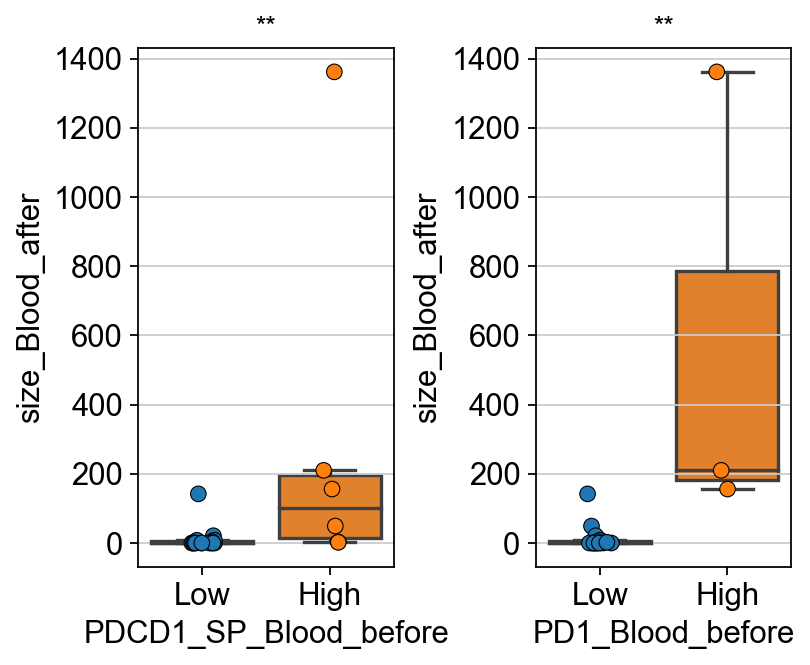

In [40]:
fig,ax=plt.subplots(ncols=2, figsize=(5,4))
fig.tight_layout(w_pad=2)
sns.boxplot(data=df_corr, 
            x='PDCD1_SP_Blood_before', 
            y='size_Blood_after',ax=ax[0], fliersize=0)
sns.stripplot(data=df_corr, 
              x='PDCD1_SP_Blood_before', 
              y='size_Blood_after',ax=ax[0],edgecolor='black', linewidth=0.5, s=7)
sns.boxplot(data=df_corr, 
            x='PD1_Blood_before', 
            y='size_Blood_after',ax=ax[1], fliersize=0)
sns.stripplot(data=df_corr, 
              x='PD1_Blood_before', 
              y='size_Blood_after',ax=ax[1],edgecolor='black', linewidth=0.5, s=7)
stat, p = kruskal(df_corr[df_corr['PDCD1_SP_Blood_before']=='Low'].size_Blood_after, 
                  df_corr[df_corr['PDCD1_SP_Blood_before']=='High'].size_Blood_after)
ax[0].set_title(convert_significance(p), fontdict= { 'fontsize': 12 })

stat, p = kruskal(df_corr[df_corr['PD1_Blood_before']=='Low'].size_Blood_after, 
                  df_corr[df_corr['PD1_Blood_before']=='High'].size_Blood_after)
ax[1].set_title(convert_significance(p), fontdict= { 'fontsize': 12 })
fig.savefig('./figures_paper/PD1_vs_expansion.svg', bbox_inches='tight')

In [41]:
sequences=pd.read_json('./VDJ/outs/all_contig_annotations.json')

In [42]:
clones=adata.obs.clone_id[adata.obs.has_ir=='True'].value_counts().sort_values(ascending=False).index.tolist()
df_temp=adata[(adata.obs.clone_id.isin(clones))&(adata.obs.has_ir=='True')].obs.astype(str).fillna('none').groupby('clone_id').agg({'clone_id_size':'first',
'leiden':lambda x:x.value_counts().index[0],
'IR_VJ_1_v_call':lambda x:x.value_counts().index[0],
'IR_VJ_1_j_call':lambda x:x.value_counts().index[0],
'IR_VJ_1_junction_aa':lambda x:x.value_counts().index[0],
'IR_VJ_1_junction':lambda x:x.value_counts().index[0],
'IR_VDJ_1_v_call':lambda x:x.value_counts().index[0],
'IR_VDJ_1_j_call':lambda x:x.value_counts().index[0],
'IR_VDJ_1_junction_aa':lambda x:x.value_counts().index[0],
'IR_VDJ_1_junction':lambda x:x.value_counts().index[0],
'IR_VJ_2_v_call':lambda x:x.value_counts().index[0],
'IR_VJ_2_j_call':lambda x:x.value_counts().index[0],
'IR_VJ_2_junction_aa':lambda x:x.value_counts().index[0],
'IR_VJ_2_junction':lambda x:x.value_counts().index[0],
'IR_VDJ_2_v_call':lambda x:x.value_counts().index[0],
'IR_VDJ_2_j_call':lambda x:x.value_counts().index[0],
'IR_VDJ_2_junction_aa':lambda x:x.value_counts().index[0],
'IR_VDJ_2_junction':lambda x:x.value_counts().index[0],
'chain_pairing':lambda x:x.value_counts().index[0]})
df_temp['size_PB-pre']=adata[(adata.obs.samplename=='PB-pre')&(adata.obs.clone_id.isin(clones))&(adata.obs.has_ir=='True')].obs.groupby('clone_id').agg({'clone_id_size':'count'})['clone_id_size']
df_temp['size_PB-post']=adata[(adata.obs.samplename=='PB-post')&(adata.obs.clone_id.isin(clones))&(adata.obs.has_ir=='True')].obs.groupby('clone_id').agg({'clone_id_size':'count'})['clone_id_size']
df_temp['size_Infusion']=adata[(adata.obs.samplename=='TIL')&(adata.obs.clone_id.isin(clones))&(adata.obs.has_ir=='True')].obs.groupby('clone_id').agg({'clone_id_size':'count'})['clone_id_size']

df_temp['alpha_1_contig']='none'
df_temp['beta_1_contig']='none'
df_temp['alpha_2_contig']='none'
df_temp['beta_2_contig']='none'
for i in range(df_temp.shape[0]):
    if df_temp.iloc[i].IR_VJ_1_junction_aa != 'none':
        df_temp.alpha_1_contig[i]=sequences[sequences.cdr3==df_temp.iloc[i].IR_VJ_1_junction_aa].sequence.value_counts().index[0]
    if df_temp.iloc[i].IR_VDJ_1_junction_aa != 'none':
        df_temp.beta_1_contig[i]=sequences[sequences.cdr3==df_temp.iloc[i].IR_VDJ_1_junction_aa].sequence.value_counts().index[0]
    if df_temp.iloc[i].IR_VJ_2_junction_aa != 'none':
        df_temp.alpha_2_contig[i]=sequences[sequences.cdr3==df_temp.iloc[i].IR_VJ_2_junction_aa].sequence.value_counts().index[0]
    if df_temp.iloc[i].IR_VDJ_2_junction_aa != 'none':
        df_temp.beta_2_contig[i]=sequences[sequences.cdr3==df_temp.iloc[i].IR_VDJ_2_junction_aa].sequence.value_counts().index[0]
df_temp.clone_id_size=df_temp.clone_id_size.str[:-2].astype(int)
df_temp[(df_temp.clone_id_size>2)&(df_temp['size_PB-pre']>0)].sort_values('clone_id_size', ascending=False).to_excel('./TCR_sequences_condensed.xls')

In [43]:
df_temp.clone_id_size=df_temp.clone_id_size.astype(float)

In [44]:
def make_contour_SP(obs_df, x, y, hue, colors=[], thresh=0.05, second_contour=None, second_contour_color='gray', single_contours=False, save=False):
    fig,ax=plt.subplots(ncols=2, nrows=2, figsize=(7,7), gridspec_kw={'height_ratios': [1, 4],
                                                                     'width_ratios': [4, 1]})
    fig.subplots_adjust(wspace=.1, hspace=.1)
    ax[0,1].axis('off')
    df_SP=obs_df
    
    #Contour plot in the middle
    if single_contours==True:
        for i, hue_value in enumerate(df_SP[hue].unique().tolist()):
            if len(colors)>0:
                sns.kdeplot(x=df_SP[df_SP[hue]==hue_value][x], y=df_SP[df_SP[hue]==hue_value][y], thresh=thresh, color=colors[i], alpha=.5, ax=ax[1,0])
            else:
                sns.kdeplot(x=df_SP[df_SP[hue]==hue_value][x], y=df_SP[df_SP[hue]==hue_value][y], thresh=thresh, alpha=.5, ax=ax[1,0])
    else:
        sns.kdeplot(x=df_SP[x], y=df_SP[y], color='gray', thresh=thresh, alpha=.5, ax=ax[1,0])
    if isinstance(second_contour, pd.DataFrame):
        sns.kdeplot(x=second_contour[x], y=second_contour[y], color=second_contour_color, alpha=.5, ax=ax[1,0], thresh=.4)
    if len(colors)>0:
        sns.scatterplot(x=df_SP[x], y=df_SP[y], hue=df_SP[hue], palette=colors, s=15, ax=ax[1,0], alpha=.75)
    else:
        sns.scatterplot(x=df_SP[x], y=df_SP[y], hue=df_SP[hue], s=15, ax=ax[1,0], alpha=.75)
    ax[1,0].legend(bbox_to_anchor=(0,-0.5,1.3,0.2), loc="lower left",mode="expand", borderaxespad=0, ncol=4)
    ax[1,0].set_xlabel(x[:-3])
    ax[1,0].set_ylabel(y[:-3])

    #x histogram
    if len(colors)>0:
        sns.kdeplot(x=df_SP[x], alpha=.5, hue=df_SP[hue], palette=colors, ax=ax[0,0], fill=True, common_norm=False)
    else:
        sns.kdeplot(x=df_SP[x], alpha=.5, hue=df_SP[hue], ax=ax[0,0], fill=True, common_norm=False)
    ax[0,0].get_legend().remove()
    ax[0,0].set_xlim(ax[1,0].get_xlim())
    ax[0,0].set_ylabel('')
    ax[0,0].set_xlabel('')
    ax[0,0].set_yticklabels([''])
    ax[0,0].set_xticklabels([''])
    ax[0,0].set_yticks([])
    sns.despine(ax=ax[0,0], bottom = False, left=True)

    #y histogram
    if len(colors)>0:
        sns.kdeplot(y=df_SP[y], alpha=.5, hue=df_SP[hue], palette=colors, ax=ax[1,1], fill=True, common_norm=False)
    else:
        sns.kdeplot(y=df_SP[y], alpha=.5, hue=df_SP[hue], ax=ax[1,1], fill=True, common_norm=False)
    ax[1,1].get_legend().remove()
    ax[1,1].set_ylim(ax[1,0].get_ylim())
    ax[1,1].set_ylabel('')
    ax[1,1].set_xlabel('')
    ax[1,1].set_yticklabels([''])
    ax[1,1].set_xticklabels([''])
    ax[1,1].set_xticks([])
    sns.despine(ax=ax[1,1], bottom = True, left=False)
    
    if save!=False:
        fig.savefig(save, bbox_inches='tight')

## Correlations with functional data

In [45]:
df_correlation=adata.obs[adata.obs.clone_id.isin(clonotypes_re_expression)]
df_correlation=df_correlation.groupby('clone_id').agg('mean')
df_correlation=df_correlation[df_correlation.index.isin(clonotypes_re_expression)]

FACS_values=pd.read_csv('FACS_mean_values_new.csv', sep=';', decimal=',', index_col=0)
for column in FACS_values.columns:
    FACS_values[column]=FACS_values[column].astype(float)
interesting_clonotypes_colors=['red','blue','orange','black','greenyellow','lightblue', 'darkviolet']

for valuename in FACS_values.columns.tolist():
    df_correlation[valuename]=FACS_values[valuename].tolist()
df_correlation['clone_id']=df_correlation.reset_index().clone_id.values.tolist()
df_correlation['clone_id']="TCR_"+df_correlation.clone_id
df_correlation.rename(columns={'cytotoxic_state':'cytotox_score',
                              'predysfunctional_state':'predysfunctional_score',
                              'dysfunctional_state':'dysfunctional_score'}, inplace=True)

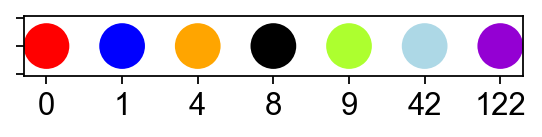

In [46]:
fig,ax=plt.subplots(figsize=(4,.5))
sns.scatterplot(x=df_correlation.index.tolist(), y=[0]*df_correlation.index.shape[0], hue=df_correlation.clone_id.tolist(),
                legend=None, palette=interesting_clonotypes_colors, s=500)
ax.grid(None)
ax.set_yticklabels('')
plt.show()
fig.savefig('./figures/clonotype_colors.svg', bbox_inches='tight')

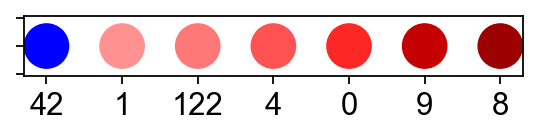

In [47]:
colors_functionality=['#0000ff', '#ff9191', '#ff7878','#ff5252','#ff2626', '#c40000','#9c0000']
order_functionality=['42', '1','122','4','0','9','8']
fig,ax=plt.subplots(figsize=(4,.5))
sns.scatterplot(x=order_functionality, y=[0]*df_correlation.index.shape[0], hue=df_correlation.clone_id.tolist(),
                legend=None, palette=colors_functionality, s=500)
ax.grid(None)
ax.set_yticklabels('')
plt.show()
fig.savefig('./figures/functionality_colors.svg', bbox_inches='tight')

In [48]:
#remove values smaller than 3 from sizes
for size in ['size_Infusion_product', 'size_Blood_before','size_Blood_after']:
    df_correlation[size][df_correlation[size]<3]=0

In [49]:
samples=['Blood_before','Infusion_product','Blood_after']

In [50]:
def convert_significance(p):
    sig=', n.s.'
    if p < 0.05:
        sig='*'
    if p < 0.01:
        sig='**'
    if p < 0.001:
        sig='***'
    if p < 0.0001:
        sig='***'
    return sig

In [51]:
measures=['naive_like_state','cytotox_score','predysfunctional_score', 'dysfunctional_score', 'activation_score',
           'frq_PD1','PD1', 'size', 'TRA_expr', 'TRB_expr', 'TCR_expr']
correlations_PB=pd.DataFrame(index=measures, columns=['EC50_IFNg_I','EC50_IL2_I','EC50_TNFa_I'])
correlations_PB_p=correlations_PB.copy()
correlations_TIL=pd.DataFrame(index=measures, columns=['EC50_IFNg_I','EC50_IL2_I','EC50_TNFa_I'])
correlations_TIL_p=correlations_TIL.copy()

In [52]:
old_samplenames=['Infusion_product', 'Blood_before', 'Blood_after']
for samplename in old_samplenames:
    df_correlation['TRA_expr_'+samplename]=0
    df_correlation['TRB_expr_'+samplename]=0
    df_correlation['TCR_expr_'+samplename]=0

for i, clonotype in enumerate([x[4:] for x in df_correlation.clone_id.unique()]):
    for j, samplename in enumerate(adata.obs.samplename.unique().tolist()):
        df_temp1=pd.DataFrame(adata[np.logical_and(adata.obs.clone_id==clonotype,adata.obs.samplename==samplename)].obs.IR_VJ_1_consensus_count)
        if df_temp1.shape[0]!=0:
            df_correlation['TRA_expr_'+old_samplenames[j]][df_correlation.clone_id=='TCR_'+clonotype]=df_temp1.IR_VJ_1_consensus_count.mean()
        
        df_temp2=pd.DataFrame(adata[np.logical_and(adata.obs.clone_id==clonotype,adata.obs.samplename==samplename)].obs.IR_VDJ_1_consensus_count)
        if df_temp2.shape[0]!=0:
            df_correlation['TRB_expr_'+old_samplenames[j]][df_correlation.clone_id=='TCR_'+clonotype]=df_temp2.IR_VDJ_1_consensus_count.mean()

        df_temp=pd.DataFrame(df_temp1['IR_VJ_1_consensus_count']+df_temp2['IR_VDJ_1_consensus_count'], columns=['TCR_expr'] )
        if df_temp.shape[0]!=0:
            df_correlation['TCR_expr_'+old_samplenames[j]][df_correlation.clone_id=='TCR_'+clonotype]=df_temp.TCR_expr.mean()
            
    print(str(np.round(((i+1)/len(df_correlation.clone_id.unique()))*100,1))+"%", end="\r", flush=True)

In [53]:
adata_pre_reexpressed=adata[(adata.obs.clone_id.isin(clonotypes_re_expression))&(adata.obs.samplename=='PB-pre')].copy()

In [54]:
adata_pre_reexpressed.obs['PDCD1']=adata_pre_reexpressed[:,adata_pre_reexpressed.var_names=='PDCD1'].X.flatten().tolist()

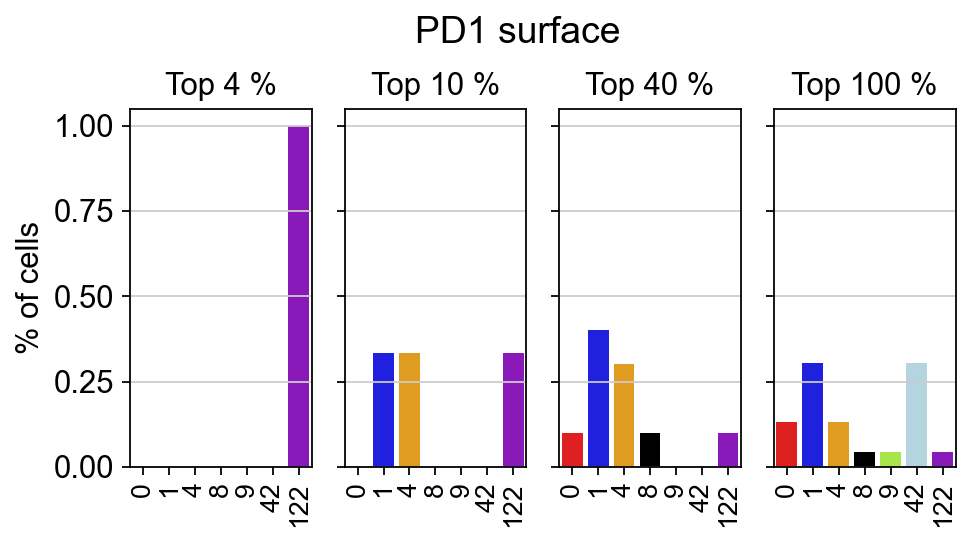

In [55]:
fig,ax=plt.subplots(ncols=4, figsize=(6,3), sharey=True)
fig.tight_layout(w_pad=.5)
for i, percentage in enumerate([4,10,40,100]):
    sns.barplot(y=adata_pre_reexpressed.obs.sort_values('CD279 (PD-1)_SP',ascending=False).clone_id[:int(adata_pre_reexpressed.shape[0]*(percentage/100))+1].value_counts(normalize=True).values,
               x=adata_pre_reexpressed.obs.sort_values('CD279 (PD-1)_SP',ascending=False).clone_id[:int(adata_pre_reexpressed.shape[0]*(percentage/100))+1].value_counts(normalize=True).index,
               ax=ax[i], palette=interesting_clonotypes_colors)
    ax[i].set_title('Top '+str(percentage)+' %')
    ax[i].set_xticklabels(ax[i].get_xticklabels(), rotation=90, size=12)
    ax[0].set_ylabel('% of cells')
    fig.suptitle('PD1 surface', y=1.1)
fig.savefig('./figures/PD_surface_fractions.svg', bbox_inches='tight')

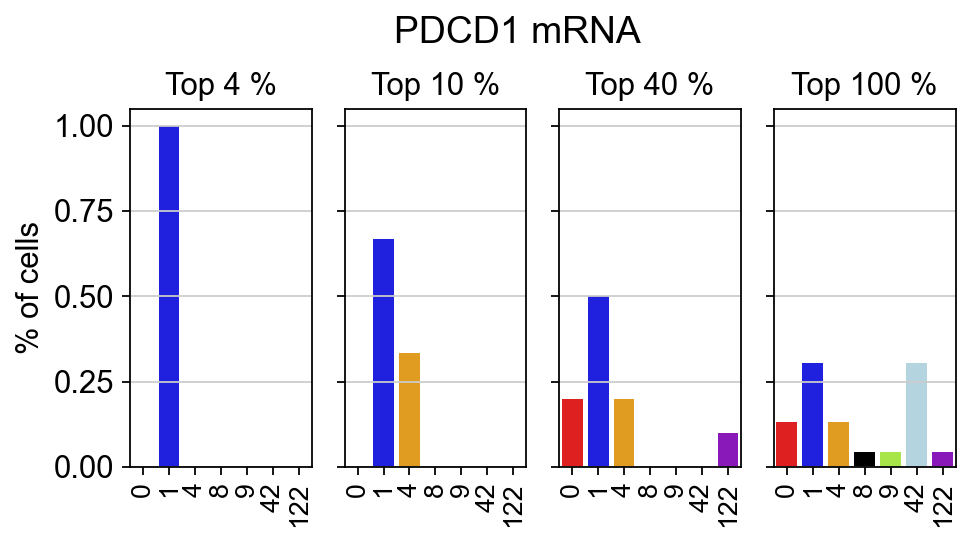

In [56]:
fig,ax=plt.subplots(ncols=4, figsize=(6,3), sharey=True)
fig.tight_layout(w_pad=.5)
for i, percentage in enumerate([4,10,40,100]):
    sns.barplot(y=adata_pre_reexpressed.obs.sort_values('PDCD1',ascending=False).clone_id[:int(adata_pre_reexpressed.shape[0]*(percentage/100))+1].value_counts(normalize=True).values,
               x=adata_pre_reexpressed.obs.sort_values('PDCD1',ascending=False).clone_id[:int(adata_pre_reexpressed.shape[0]*(percentage/100))+1].value_counts(normalize=True).index,
               ax=ax[i], palette=interesting_clonotypes_colors)
    ax[i].set_title('Top '+str(percentage)+' %')
    ax[i].set_xticklabels(ax[i].get_xticklabels(), rotation=90, size=12)
    ax[0].set_ylabel('% of cells')
    fig.suptitle('PDCD1 mRNA', y=1.1)
fig.savefig('./figures/PDCD1_mRNA_fractions.svg', bbox_inches='tight')

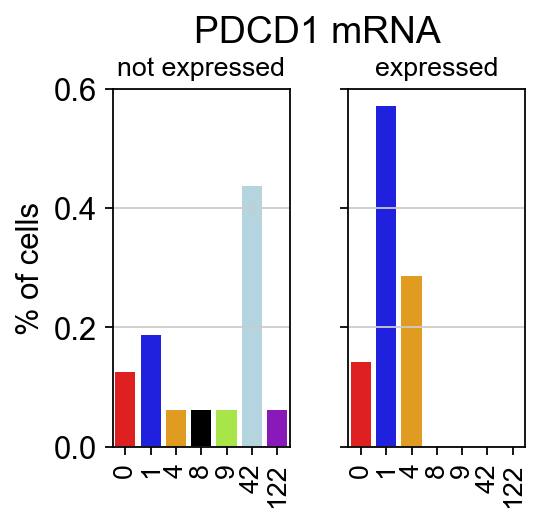

In [57]:
fig,ax=plt.subplots(ncols=2, figsize=(3.5,3), sharey=True)
fig.tight_layout(w_pad=.5)
sns.barplot(y=adata_pre_reexpressed.obs.sort_values('PDCD1',ascending=False).clone_id[adata_pre_reexpressed.obs.PDCD1<=0].value_counts(normalize=True).values,
            x=adata_pre_reexpressed.obs.sort_values('PDCD1',ascending=False).clone_id[adata_pre_reexpressed.obs.PDCD1<=0].value_counts(normalize=True).index,
            ax=ax[0], palette=interesting_clonotypes_colors)
ax[0].set_title('not expressed', size=12)
sns.barplot(y=adata_pre_reexpressed.obs.sort_values('PDCD1',ascending=False).clone_id[adata_pre_reexpressed.obs.PDCD1>0].value_counts(normalize=True).values,
            x=adata_pre_reexpressed.obs.sort_values('PDCD1',ascending=False).clone_id[adata_pre_reexpressed.obs.PDCD1>0].value_counts(normalize=True).index,
            ax=ax[1], palette=interesting_clonotypes_colors)
ax[1].set_title('expressed', size=12)
for i,axes in enumerate(ax):
    ax[i].set_xticklabels(ax[i].get_xticklabels(), rotation=90, size=12)
ax[0].set_ylabel('% of cells')
fig.suptitle('PDCD1 mRNA', y=1.06, x=0.53)
fig.savefig('./figures/PDCD1_mRNA_boolean.svg', bbox_inches='tight')

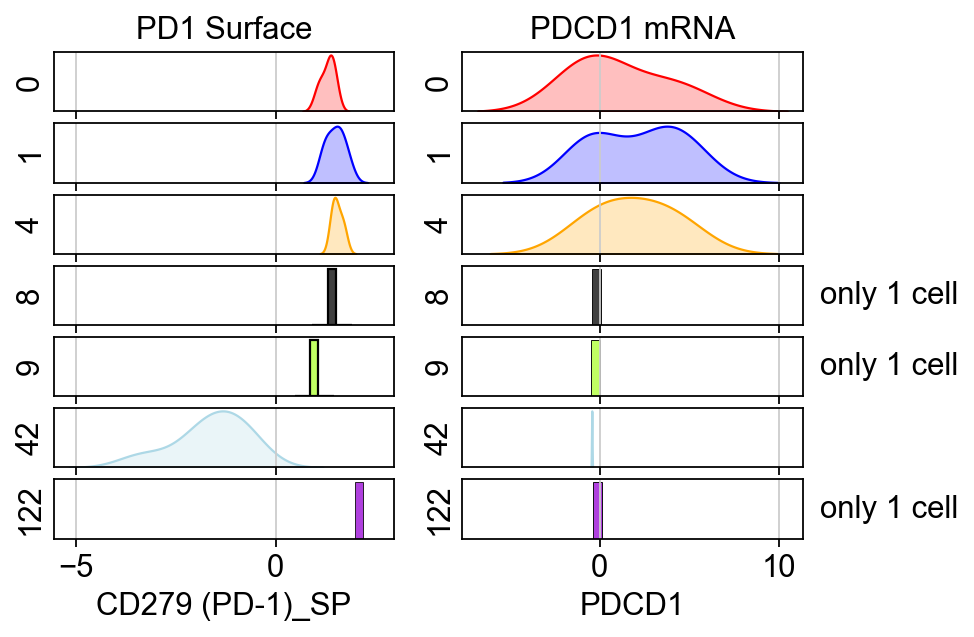

In [58]:
fig,ax=plt.subplots(ncols=2, nrows=len(adata_pre_reexpressed.obs.clone_id.unique()), sharex='col', figsize=(6,4))
for i, clonotype in enumerate(['0','1','4','8','9','42','122']):
    sns.kdeplot(adata_pre_reexpressed.obs['CD279 (PD-1)_SP'][adata_pre_reexpressed.obs.clone_id==clonotype], color=interesting_clonotypes_colors[i], ax=ax[i,0], fill=True)
    if len(adata_pre_reexpressed.obs.PDCD1[adata_pre_reexpressed.obs.clone_id==clonotype])<2:
        #ax[i,0].text(x=.5, y=.5, s='only 1 cell', horizontalalignment='center',
        #verticalalignment='center', transform = ax[i,0].transAxes)
        sns.histplot(adata_pre_reexpressed.obs['CD279 (PD-1)_SP'][adata_pre_reexpressed.obs.clone_id==clonotype],
                     color=interesting_clonotypes_colors[i], ax=ax[i,0], bins=5)
    ax[i,0].set_yticks([])
    ax[i,0].set_ylabel(clonotype)
ax[0,0].set_title('PD1 Surface')

for i, clonotype in enumerate(['0','1','4','8','9','42','122']):
    sns.kdeplot(adata_pre_reexpressed.obs.PDCD1[adata_pre_reexpressed.obs.clone_id==clonotype], color=interesting_clonotypes_colors[i], ax=ax[i,1], fill=True)
    if len(adata_pre_reexpressed.obs.PDCD1[adata_pre_reexpressed.obs.clone_id==clonotype])<2:
        ax[i,1].text(x=1.05, y=.5, s='only 1 cell', horizontalalignment='left',
        verticalalignment='center', transform = ax[i,1].transAxes)
        sns.histplot(adata_pre_reexpressed.obs.PDCD1[adata_pre_reexpressed.obs.clone_id==clonotype],
                     color=interesting_clonotypes_colors[i], ax=ax[i,1], bins=2)
    ax[i,1].set_yticks([])
    ax[i,1].set_ylabel(clonotype)
ax[0,1].set_title('PDCD1 mRNA')
limit_PD1=ax[0,0].get_xlim()
fig.savefig('./figures/PD1_expression_patterns.svg', bbox_inches='tight')

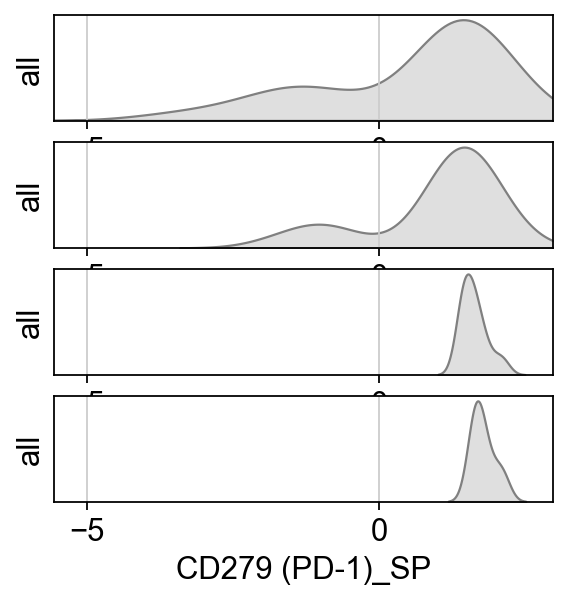

In [59]:
fig,ax=plt.subplots(nrows=4, figsize=(4,4))
for i, thresh in enumerate([24, 20, 10, 5]):
    sns.kdeplot(adata_pre_reexpressed.obs.sort_values('CD279 (PD-1)_SP', ascending=False)[:thresh]['CD279 (PD-1)_SP'],
                ax=ax[i], color='gray', fill=True)
    ax[i].set_yticks([])
    ax[i].set_xticks([-5,0])
    ax[i].set_ylabel('all')
    ax[i].set_xlim(limit_PD1)
fig.savefig('./figures/PD1_expression_patterns_combined.svg', bbox_inches='tight')

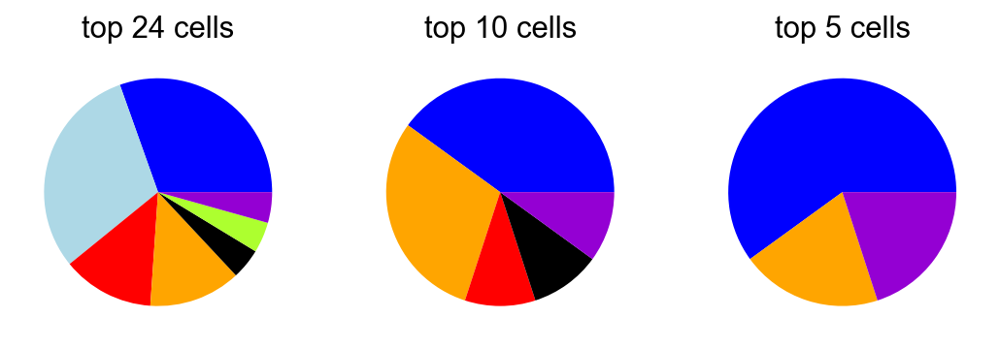

In [60]:
fig,ax=plt.subplots(ncols=3, figsize=(8,4))
for i, thresh in enumerate([24, 10, 5]):
    data=adata_pre_reexpressed.obs.sort_values('CD279 (PD-1)_SP', ascending=False)[:thresh]['clone_id'].value_counts()
    colors=[interesting_clonotypes_colors[clonotypes_re_expression.index(clonotype)] for clonotype in data.index]
    ax[i].pie(data,colors=colors)
    ax[i].set_title("top "+str(thresh)+" cells")
fig.savefig('./figures/PD1_gating_pies.svg', bbox_inches='tight')    

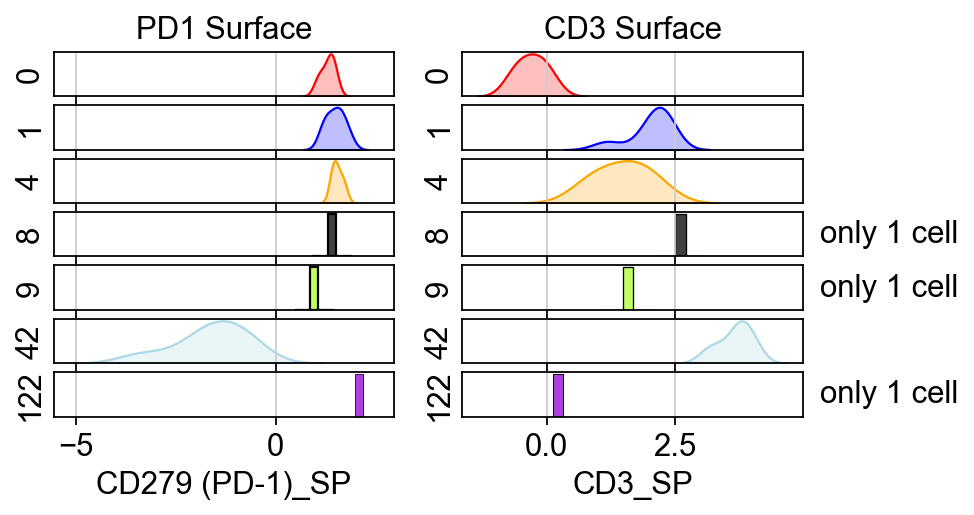

In [61]:
fig,ax=plt.subplots(ncols=2, nrows=len(adata_pre_reexpressed.obs.clone_id.unique()), sharex='col', figsize=(6,3))
for i, clonotype in enumerate(['0','1','4','8','9','42','122']):
    sns.kdeplot(adata_pre_reexpressed.obs['CD279 (PD-1)_SP'][adata_pre_reexpressed.obs.clone_id==clonotype], color=interesting_clonotypes_colors[i], ax=ax[i,0], fill=True)
    if len(adata_pre_reexpressed.obs.PDCD1[adata_pre_reexpressed.obs.clone_id==clonotype])<2:
        #ax[i,0].text(x=.5, y=.5, s='only 1 cell', horizontalalignment='center',
        #verticalalignment='center', transform = ax[i,0].transAxes)
        sns.histplot(adata_pre_reexpressed.obs['CD279 (PD-1)_SP'][adata_pre_reexpressed.obs.clone_id==clonotype],
                     color=interesting_clonotypes_colors[i], ax=ax[i,0], bins=5)
    ax[i,0].set_yticks([])
    ax[i,0].set_ylabel(clonotype)
ax[0,0].set_title('PD1 Surface')

for i, clonotype in enumerate(['0','1','4','8','9','42','122']):
    sns.kdeplot(adata_pre_reexpressed.obs.CD3_SP[adata_pre_reexpressed.obs.clone_id==clonotype], color=interesting_clonotypes_colors[i], ax=ax[i,1], fill=True)
    if len(adata_pre_reexpressed.obs.CD3_SP[adata_pre_reexpressed.obs.clone_id==clonotype])<2:
        ax[i,1].text(x=1.05, y=.5, s='only 1 cell', horizontalalignment='left',
        verticalalignment='center', transform = ax[i,1].transAxes)
        sns.histplot(adata_pre_reexpressed.obs.CD3_SP[adata_pre_reexpressed.obs.clone_id==clonotype],
                     color=interesting_clonotypes_colors[i], ax=ax[i,1], bins=5)
    ax[i,1].set_yticks([])
    ax[i,1].set_ylabel(clonotype)
ax[0,1].set_title('CD3 Surface')
fig.savefig('./figures/PD1_CD3_expression_patterns.svg', bbox_inches='tight')

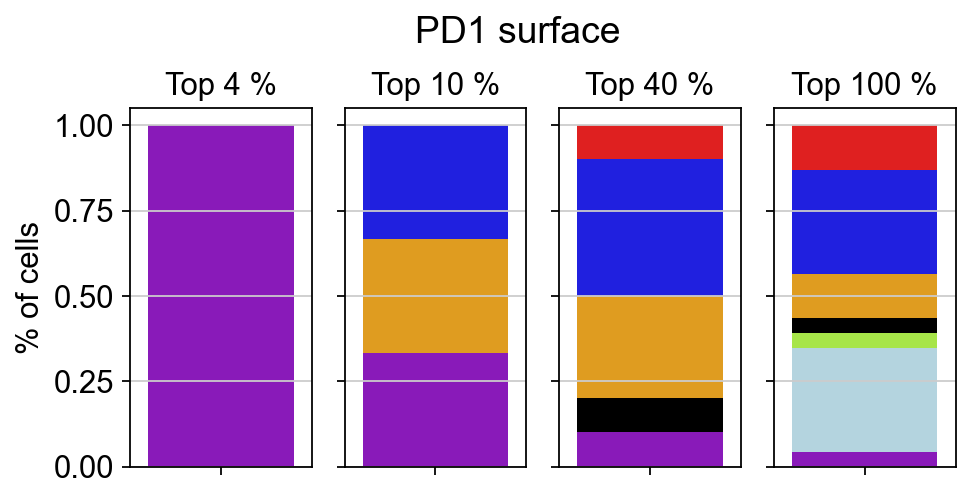

In [62]:
fig,ax=plt.subplots(ncols=4, figsize=(6,3), sharey=True)
fig.tight_layout(w_pad=.5)
for i, percentage in enumerate([4,10,40,100]):
    for j in range(len(['0','1','4','8','9','42','122'])):
        sns.barplot(y=[adata_pre_reexpressed.obs.sort_values('CD279 (PD-1)_SP',ascending=False).clone_id[:int(adata_pre_reexpressed.shape[0]*(percentage/100))+1].value_counts(normalize=True)[(['0','1','4','8','9','42','122'][j:])].sum()],
                    ax=ax[i], color=interesting_clonotypes_colors[j])
    ax[i].set_title('Top '+str(percentage)+' %')
    ax[i].set_xticklabels(ax[i].get_xticklabels(), rotation=90, size=12)
    ax[0].set_ylabel('% of cells')
    fig.suptitle('PD1 surface', y=1.1)
fig.savefig('./figures/PD_surface_fractions_stacked.svg', bbox_inches='tight')

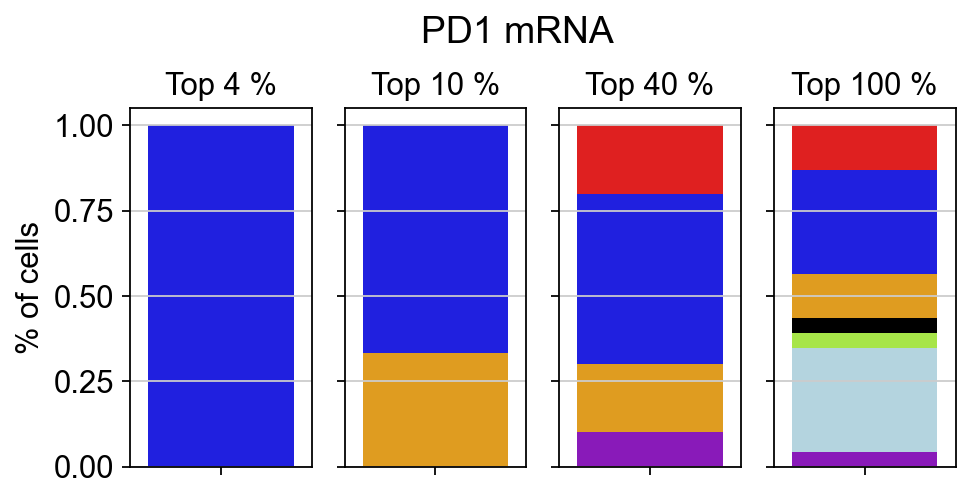

In [63]:
fig,ax=plt.subplots(ncols=4, figsize=(6,3), sharey=True)
fig.tight_layout(w_pad=.5)
for i, percentage in enumerate([4,10,40,100]):
    for j in range(len(['0','1','4','8','9','42','122'])):
        sns.barplot(y=[adata_pre_reexpressed.obs.sort_values('PDCD1',ascending=False).clone_id[:int(adata_pre_reexpressed.shape[0]*(percentage/100))+1].value_counts(normalize=True)[(['0','1','4','8','9','42','122'][j:])].sum()],
                    ax=ax[i], color=interesting_clonotypes_colors[j])
    ax[i].set_title('Top '+str(percentage)+' %')
    ax[i].set_xticklabels(ax[i].get_xticklabels(), rotation=90, size=12)
    ax[0].set_ylabel('% of cells')
    fig.suptitle('PD1 mRNA', y=1.1)
fig.savefig('./figures/PD_mRNA_fractions_stacked.svg', bbox_inches='tight')

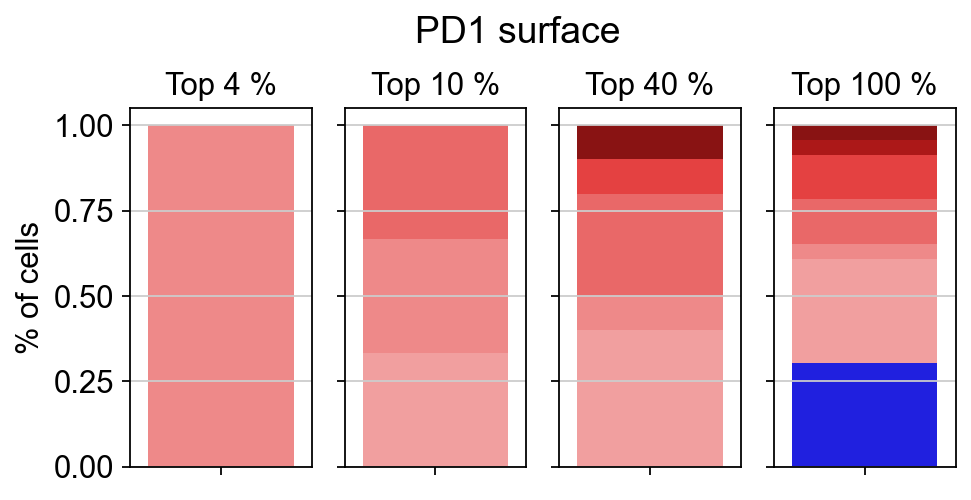

In [64]:
fig,ax=plt.subplots(ncols=4, figsize=(6,3), sharey=True)
fig.tight_layout(w_pad=.5)
for i, percentage in enumerate([4,10,40,100]):
    for j in range(len(order_functionality[::-1])):
        sns.barplot(y=[adata_pre_reexpressed.obs.sort_values('CD279 (PD-1)_SP',ascending=False).clone_id[:int(adata_pre_reexpressed.shape[0]*(percentage/100))+1].value_counts(normalize=True)[(order_functionality[::-1][j:])].sum()],
                    ax=ax[i], color=colors_functionality[::-1][j])
    ax[i].set_title('Top '+str(percentage)+' %')
    ax[i].set_xticklabels(ax[i].get_xticklabels(), rotation=90, size=12)
    ax[0].set_ylabel('% of cells')
    fig.suptitle('PD1 surface', y=1.1)
fig.savefig('./figures/PD_surface_fractions_stacked_functionality.svg', bbox_inches='tight')

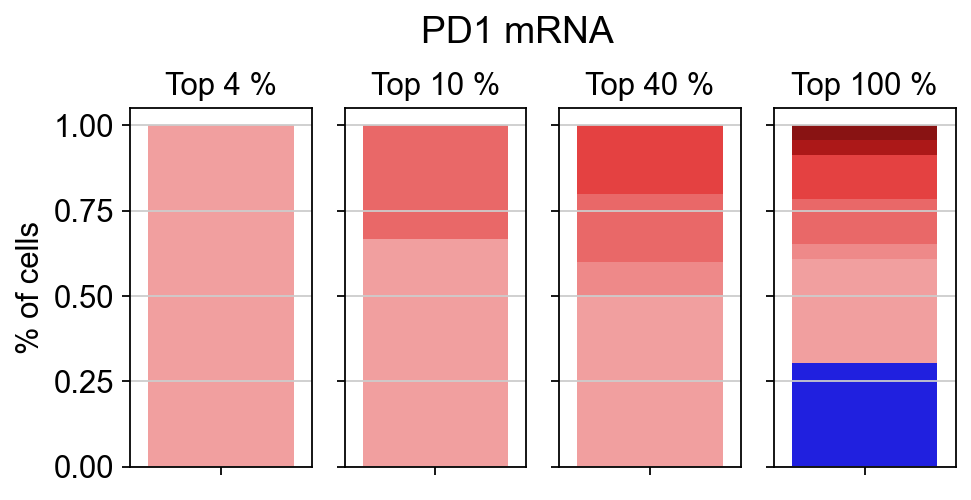

In [65]:
fig,ax=plt.subplots(ncols=4, figsize=(6,3), sharey=True)
fig.tight_layout(w_pad=.5)
for i, percentage in enumerate([4,10,40,100]):
    for j in range(len(order_functionality[::-1])):
        sns.barplot(y=[adata_pre_reexpressed.obs.sort_values('PDCD1',ascending=False).clone_id[:int(adata_pre_reexpressed.shape[0]*(percentage/100))+1].value_counts(normalize=True)[(order_functionality[::-1][j:])].sum()],
                    ax=ax[i], color=colors_functionality[::-1][j])
    ax[i].set_title('Top '+str(percentage)+' %')
    ax[i].set_xticklabels(ax[i].get_xticklabels(), rotation=90, size=12)
    ax[0].set_ylabel('% of cells')
    fig.suptitle('PD1 mRNA', y=1.1)
fig.savefig('./figures/PD_mRNA_fractions_stacked_functionality.svg', bbox_inches='tight')

In [66]:
adata_pre_reexpressed.obs['functionality_bool']='functional'
adata_pre_reexpressed.obs['functionality_bool'][adata_pre_reexpressed.obs.clone_id=='42']='non-functional'

... storing 'functionality_bool' as categorical


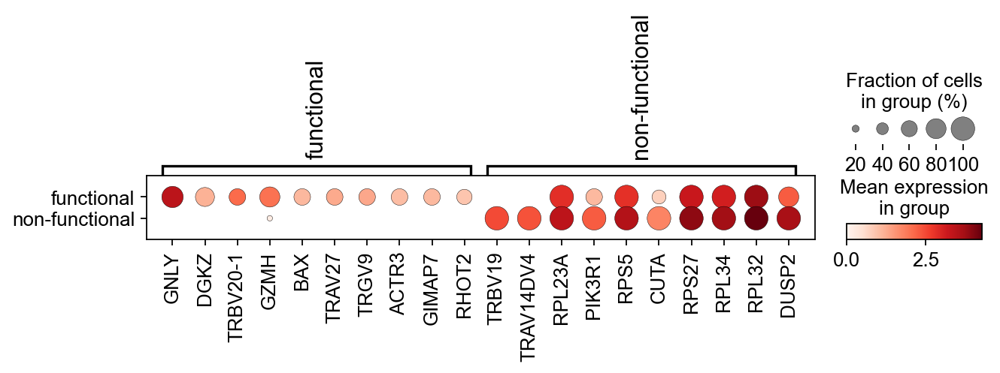

In [67]:
sc.tl.rank_genes_groups(adata_pre_reexpressed, groupby='functionality_bool')
sc.pl.rank_genes_groups_dotplot(adata_pre_reexpressed, groupby='functionality_bool')

In [68]:
FACS_values.index=FACS_values.index.str[4:].tolist()

In [69]:
FACS_values=FACS_values.fillna(0)

In [70]:
adata_pre_reexpressed.obs=pd.merge(adata_pre_reexpressed.obs, FACS_values, left_on='clone_id', right_index=True)

In [71]:
df_temp=pd.merge(pd.DataFrame(adata_pre_reexpressed.X, index=adata_pre_reexpressed.obs_names, 
                              columns=adata_pre_reexpressed.var_names), 
                 adata_pre_reexpressed.obs[['EC50_IFNg_I','EC50_IL2_I','EC50_TNFa_I']], left_index=True, 
                 right_index=True)

In [72]:
df_enriching_proteins=pd.DataFrame(index=adata_pre_reexpressed.obs.columns[adata_pre_reexpressed.obs.columns.str.endswith('_SP')].tolist())
for cutoff in range(1,24):
    for protein in adata_pre_reexpressed.obs.columns[adata_pre_reexpressed.obs.columns.str.endswith('_SP')].tolist():
        df_enriching_proteins.loc[protein,[x+'_'+str(cutoff) for x in ['EC50_IFNg_I','EC50_IL2_I','EC50_TNFa_I']]]=adata_pre_reexpressed.obs.sort_values(protein,ascending=False)[:cutoff][['EC50_IFNg_I','EC50_IL2_I','EC50_TNFa_I']].mean().tolist()
        #df_enriching_proteins.loc[protein,'n_cells'+'_'+str(cutoff)]=df_temp.sort_values(gene,ascending=False)[:cutoff].shape[0]
        #df_enriching_proteins.loc[protein,'n_clones'+'_'+str(cutoff)]=adata_pre_reexpressed.obs.loc[df_temp.sort_values(gene,ascending=False)[:cutoff].clone_id.nunique()
        #df_enriching_proteins.loc[protein,'%_42'+'_'+str(cutoff)]=adata_pre_reexpressed.obs.loc[df_temp.sort_values(protein,ascending=False)[:cutoff].clone_id.value_counts(normalize=True)['42']

In [73]:
def integrate(y_vals, h):
    i = 1
    total = y_vals[0] + y_vals[-1]
    for y in y_vals[1:-1]:
        if i % 2 == 0:
            total += 2 * y
        else:
            total += 4 * y
        i += 1
    return total * (h / 3.0)

In [74]:
for protein in adata_pre_reexpressed.obs.columns[adata_pre_reexpressed.obs.columns.str.endswith('_SP')].tolist():
    df_enriching_proteins.loc[protein,'AUC']=integrate(df_enriching_proteins.loc[protein,df_enriching_proteins.columns.str.contains('IFNg')].values.tolist(), 1)

In [75]:
proteins=df_enriching_proteins.sort_values(df_enriching_proteins.columns[df_enriching_proteins.columns.str.contains('IFNg')].tolist(), ascending=False).index

In [76]:
proteins=df_enriching_proteins.sort_values('AUC', ascending=False).index

In [77]:
proteins=proteins[~proteins.str.contains('Ctrl')].tolist()
proteins=proteins

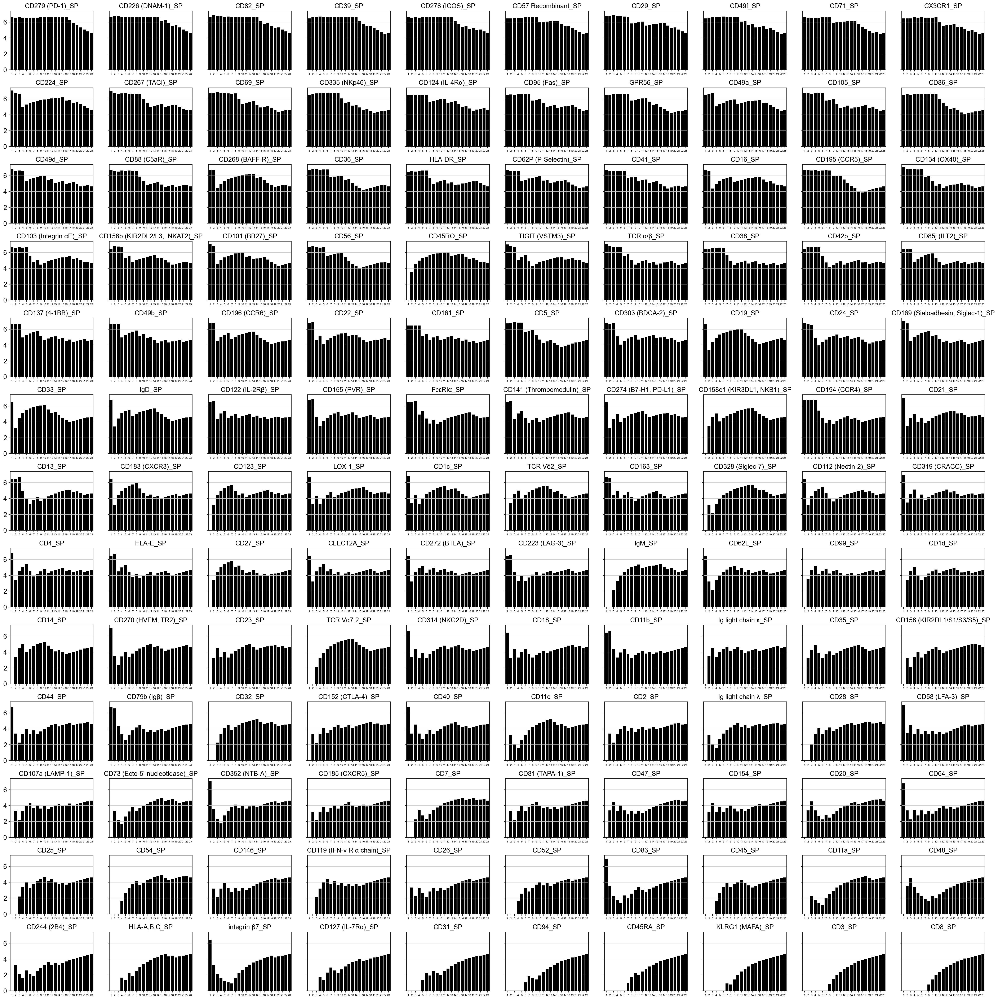

In [78]:
fig,ax=plt.subplots(ncols=10, nrows=13, figsize=(30,30), sharey=True)
fig.tight_layout(h_pad=1)
for i, protein in enumerate(proteins):
    sns.barplot(y=df_enriching_proteins.loc[protein,df_enriching_proteins.columns.str.contains('IFNg')].values, 
                x=df_enriching_proteins.loc[protein,df_enriching_proteins.columns.str.contains('IFNg')].index, color='black',
                ax=ax.reshape(-1)[i])
    ax.reshape(-1)[i].set_title(protein)
    ax.reshape(-1)[i].set_xticklabels(range(1,24), size=6)
fig.savefig('./figures/protein_functional_enrichment.svg', bbox_inches='tight')

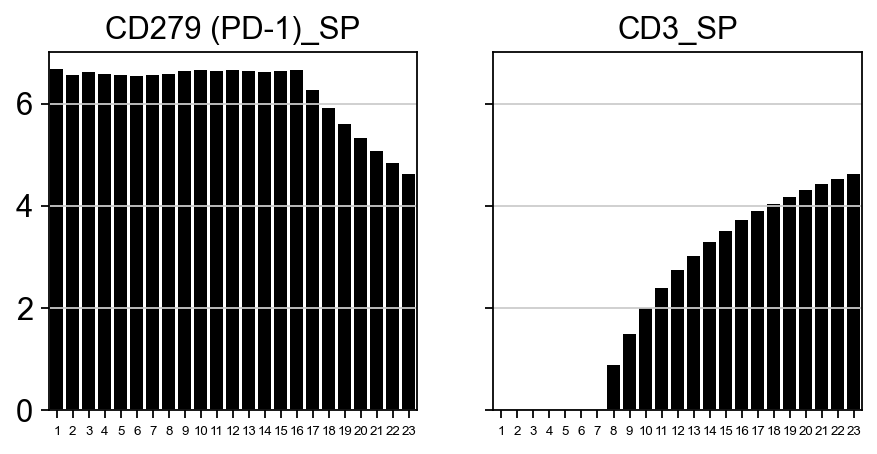

In [79]:
fig,ax=plt.subplots(ncols=2, figsize=(6,3), sharey=True)
fig.tight_layout(h_pad=1)
for i, protein in enumerate(['CD279 (PD-1)_SP','CD3_SP']):
    sns.barplot(y=df_enriching_proteins.loc[protein,df_enriching_proteins.columns.str.contains('IFNg')].values, 
                x=df_enriching_proteins.loc[protein,df_enriching_proteins.columns.str.contains('IFNg')].index, color='black',
                ax=ax.reshape(-1)[i])
    ax.reshape(-1)[i].set_title(protein)
    ax.reshape(-1)[i].set_xticklabels(range(1,24), size=6)
fig.savefig('./figures/protein_functional_enrichment_selected.svg', bbox_inches='tight')

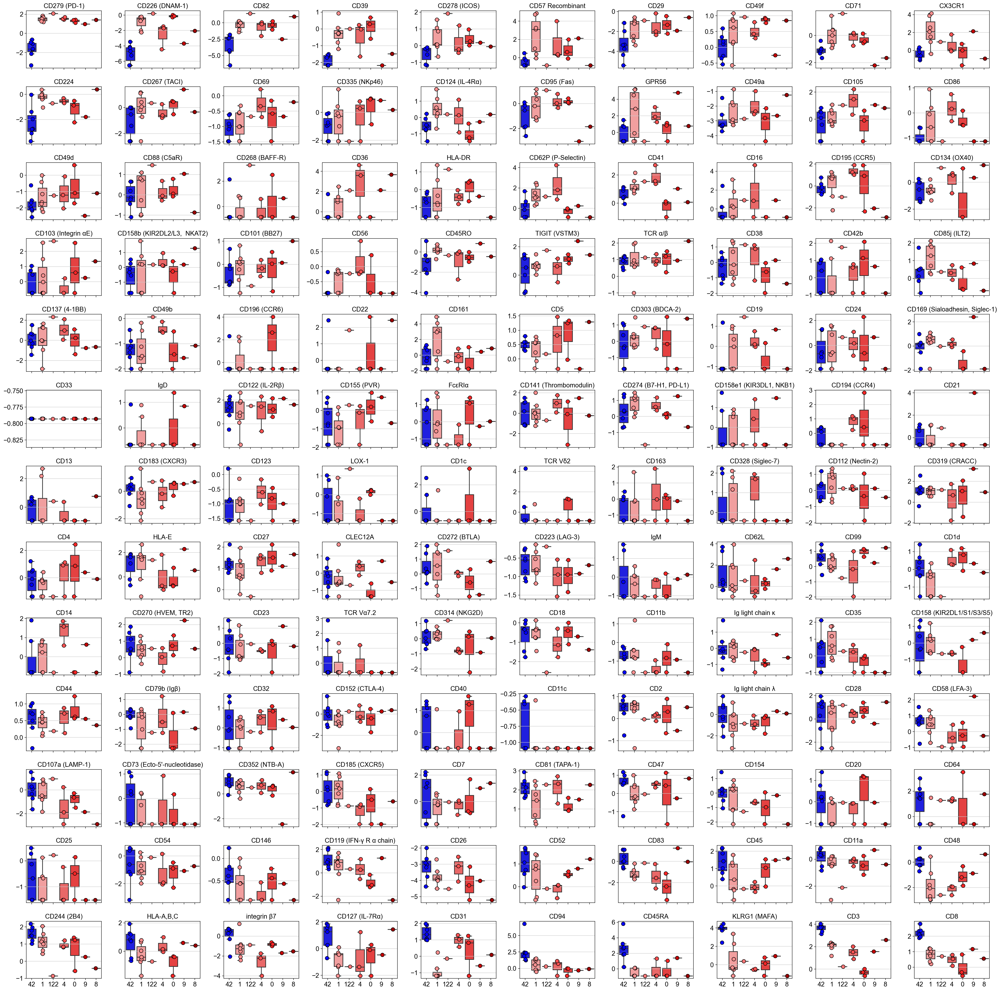

In [80]:
fig,ax=plt.subplots(ncols=10, nrows=13, figsize=(30,30), sharex=True)
fig.tight_layout(h_pad=2)
for i, protein in enumerate(proteins):
    sns.boxplot(y=adata_pre_reexpressed.obs[protein], 
                x=adata_pre_reexpressed.obs['clone_id'],
                ax=ax.reshape(-1)[i], palette=colors_functionality, order=order_functionality)
    sns.stripplot(y=adata_pre_reexpressed.obs[protein], 
                x=adata_pre_reexpressed.obs['clone_id'], size=8, edgecolor='black', linewidth=1,
                ax=ax.reshape(-1)[i], palette=colors_functionality, order=order_functionality)
    ax.reshape(-1)[i].set_title(protein[:-3])
    ax.reshape(-1)[i].set_xlabel('')
    ax.reshape(-1)[i].set_ylabel('')
fig.savefig('./figures/protein_functional_enrichment_clonotypes.svg', bbox_inches='tight')

In [81]:
df_enriching_proteins=df_enriching_proteins[~df_enriching_proteins.index.str.contains('Ctrl')]

In [83]:
matrix=df_enriching_proteins.sort_values('AUC', ascending=False).loc[df_enriching_proteins.index!='AUC',df_enriching_proteins.columns.str.contains('IFNg')]

In [84]:
matrix=matrix[matrix.columns[::-1]]

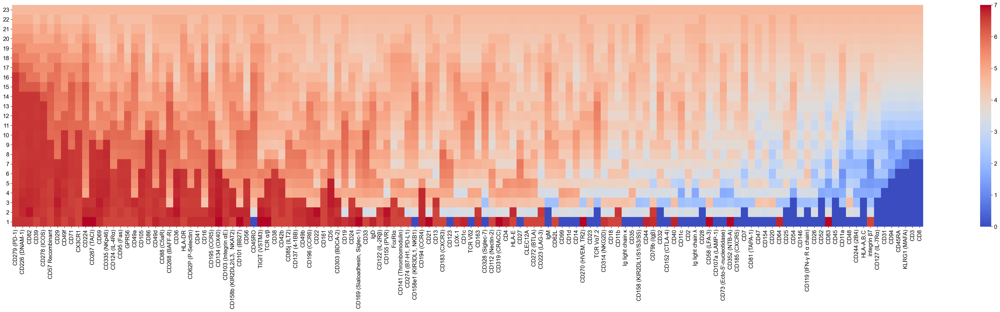

In [85]:
fig,ax=plt.subplots(figsize=(50,10))
sns.heatmap(matrix.T, cmap='coolwarm', vmin=0, vmax=7, ax=ax, yticklabels=range(1,24)[::-1])
ax.set_yticklabels(ax.get_yticklabels(), rotation=0)
ax.set_xticklabels([x.get_text()[:-3] for x in ax.get_xticklabels()])
fig.savefig('./figures/mean_EC50_heatmap.svg', bbox_inches='tight')

In [86]:
adata_for_raw = sc.read_10x_mtx(
    "./GEX/outs/filtered_feature_bc_matrix/",
    var_names='gene_symbols',               
    cache=True, gex_only=False)                         
adata_for_raw.var_names_make_unique()

adata_SP=adata_for_raw[:,adata_for_raw.var.feature_types!='Gene Expression'].copy()
adata_ADT=adata_SP[:,adata_SP.var.gene_ids.str.contains('C')].copy()

In [87]:
adata_ADT.var_names=naming_reference.Description

... storing 'feature_types' as categorical


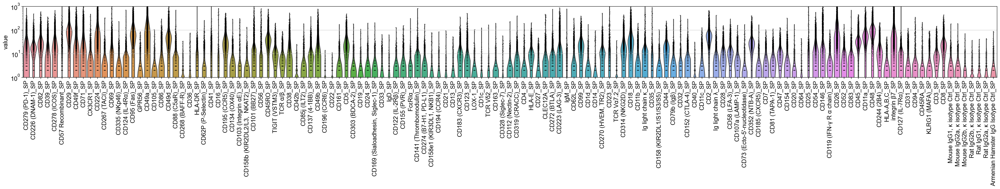

In [88]:
fig,ax=plt.subplots(figsize=(40,3))
sc.pl.violin(adata_ADT, keys=proteins+adata_ADT.var_names[adata_ADT.var_names.str.contains('Ctrl')].tolist(), ax=ax, show=False)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
ax.set_yscale('log')
ax.set_ylim([1,1000])
fig.savefig('./figures/surface_protein_counts.svg', bbox_inches='tight')

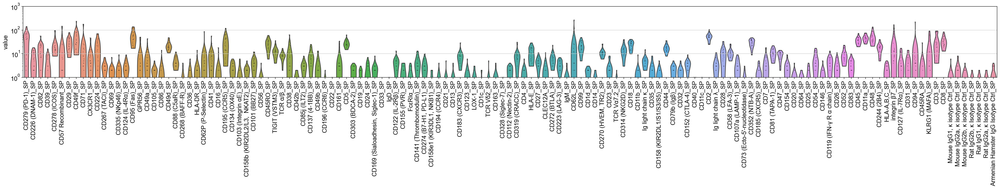

In [89]:
fig,ax=plt.subplots(figsize=(40,3))
sc.pl.violin(adata_ADT[adata_ADT.obs_names.isin(adata_pre_reexpressed.obs_names)], keys=proteins+adata_ADT.var_names[adata_ADT.var_names.str.contains('Ctrl')].tolist(), ax=ax, show=False)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
ax.set_yscale('log')
ax.set_ylim([1,1000])
fig.savefig('./figures/surface_protein_counts_PBpre.svg', bbox_inches='tight')

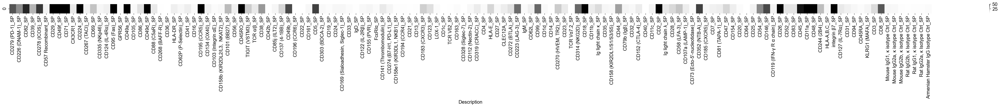

In [90]:
fig,ax=plt.subplots(figsize=(60,0.5))
sns.heatmap(pd.DataFrame(adata_ADT.X.todense().mean(axis=0).tolist()[0], index=adata_ADT.var_names).T[proteins+adata_ADT.var_names[adata_ADT.var_names.str.contains('Ctrl')].tolist()], cmap='Greys', ax=ax, vmax=50)
fig.savefig('./figures/surface_protein_counts_heatmap.svg', bbox_inches='tight')

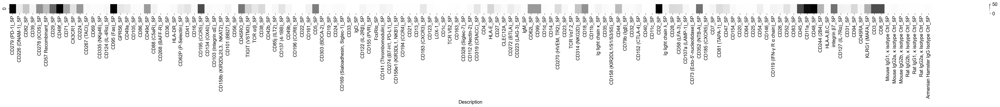

In [91]:
fig,ax=plt.subplots(figsize=(60,0.5))
sns.heatmap(pd.DataFrame(adata_ADT[adata_ADT.obs_names.isin(adata_pre_reexpressed.obs_names)].X.todense().mean(axis=0).tolist()[0], index=adata_ADT.var_names).T[proteins+adata_ADT.var_names[adata_ADT.var_names.str.contains('Ctrl')].tolist()], cmap='Greys', ax=ax, vmax=50)
fig.savefig('./figures/surface_protein_counts_heatmap_PBpre.svg', bbox_inches='tight')

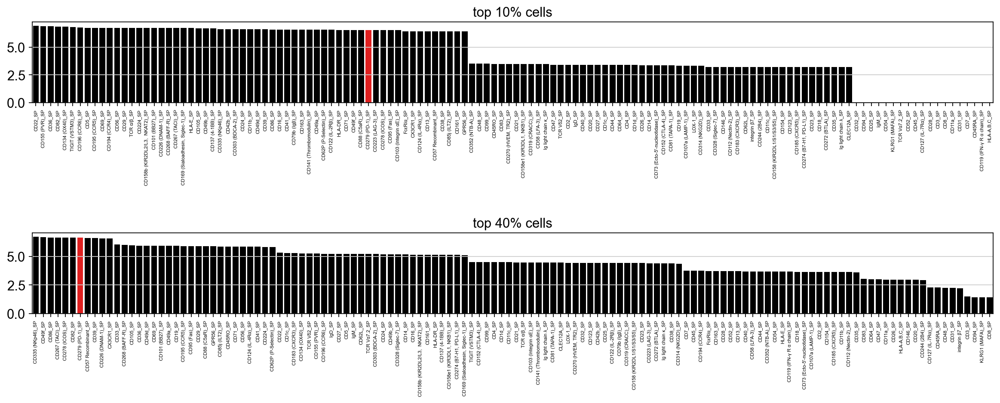

In [92]:
fig,ax=plt.subplots(nrows=2, figsize=(15,5))
fig.tight_layout(h_pad=8)
sns.barplot(x=df_enriching_proteins.loc[df_enriching_proteins.index!='AUC',df_enriching_proteins.columns.str.contains('IFNg')].sort_values('EC50_IFNg_I_2', ascending=False).index,
            y=df_enriching_proteins.loc[df_enriching_proteins.index!='AUC',df_enriching_proteins.columns.str.contains('IFNg')].sort_values('EC50_IFNg_I_2', ascending=False)['EC50_IFNg_I_2'].values,
            palette=['red' if x=='CD279 (PD-1)_SP' else 'black' for x in df_enriching_proteins.loc[df_enriching_proteins.index!='AUC',df_enriching_proteins.columns.str.contains('IFNg')].sort_values('EC50_IFNg_I_2', ascending=False).index], ax=ax[0])
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=90, size=5)
ax[0].set_title('top 10% cells')

sns.barplot(x=df_enriching_proteins.loc[df_enriching_proteins.index!='AUC',df_enriching_proteins.columns.str.contains('IFNg')].sort_values('EC50_IFNg_I_9', ascending=False).index,
            y=df_enriching_proteins.loc[df_enriching_proteins.index!='AUC',df_enriching_proteins.columns.str.contains('IFNg')].sort_values('EC50_IFNg_I_9', ascending=False)['EC50_IFNg_I_9'].values,
            palette=['red' if x=='CD279 (PD-1)_SP' else 'black' for x in df_enriching_proteins.loc[df_enriching_proteins.index!='AUC',df_enriching_proteins.columns.str.contains('IFNg')].sort_values('EC50_IFNg_I_9', ascending=False).index], ax=ax[1])
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation=90, size=5)
ax[1].set_title('top 40% cells')

plt.show()
fig.savefig('./figures/protein_top10-top40_percent_cells.svg', bbox_inches='tight')

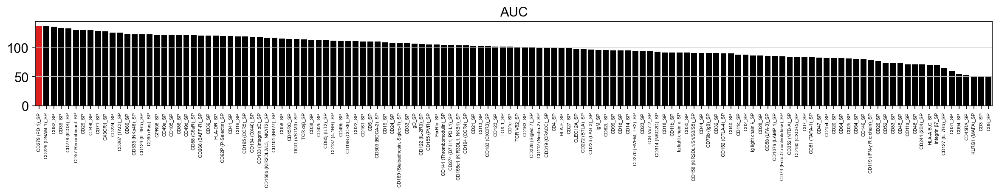

In [93]:
fig,ax=plt.subplots(figsize=(15,2))
fig.tight_layout(h_pad=3)
sns.barplot(x=df_enriching_proteins.sort_values('AUC', ascending=False)['AUC'].index,
            y=df_enriching_proteins.sort_values('AUC', ascending=False)['AUC'].values,
            palette=['red' if x=='CD279 (PD-1)_SP' else 'black' for x in df_enriching_proteins.sort_values('AUC', ascending=False).index], ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, size=5)
ax.set_title('AUC')
fig.savefig('./figures/AUC.svg', bbox_inches='tight')

In [94]:
data=adata.obs.groupby('clone_id').agg({'size_Blood_before':'mean',
                                  'size_Infusion_product':'mean',
                                  'size_Blood_after':'mean'})

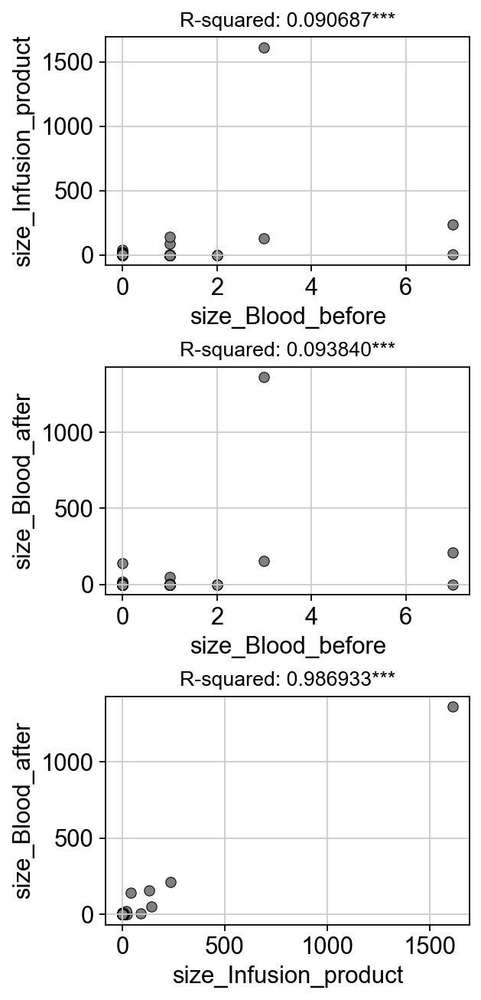

In [95]:
fig, ax =plt.subplots(nrows=3, figsize=(4,8))
fig.tight_layout(h_pad=2.5)
sns.scatterplot(data=data, x='size_Blood_before', y='size_Infusion_product', edgecolor='black', color='gray', ax=ax[0])
slope, intercept, r_value, p_value, std_err = stats.linregress(data['size_Blood_before'], data['size_Infusion_product'])
ax[0].set_title(label=("R-squared: %f" % r_value**2)+convert_significance(p_value), size=12)

sns.scatterplot(data=data, x='size_Blood_before', y='size_Blood_after', edgecolor='black', color='gray', ax=ax[1])
slope, intercept, r_value, p_value, std_err = stats.linregress(data['size_Blood_before'], data['size_Blood_after'])
ax[1].set_title(label=("R-squared: %f" % r_value**2)+convert_significance(p_value), size=12)

sns.scatterplot(data=data, x='size_Infusion_product', y='size_Blood_after', edgecolor='black', color='gray', ax=ax[2])
slope, intercept, r_value, p_value, std_err = stats.linregress(data['size_Infusion_product'], data['size_Blood_after'])
ax[2].set_title(label=("R-squared: %f" % r_value**2)+convert_significance(p_value), size=12)

fig.savefig('./figures_paper/size_correlations.svg', bbox_inches='tight')